In [1]:
ls /data/yosef3/users/can/mrvi_ibd/new_conda

mrvi/  scvi-v2/


In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=1
%env XLA_PYTHON_CLIENT_ALLOCATOR=platform

import torch
for i in range(torch.cuda.device_count()):
   print(torch.cuda.get_device_properties(i).name)
mem = torch.cuda.mem_get_info()
mem[0]/mem[1]

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=1
env: XLA_PYTHON_CLIENT_ALLOCATOR=platform


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Tesla V100-PCIE-32GB


0.7971729504948971

In [3]:
import sys
sys.path.insert(0, '/data/yosef3/users/can/mrvi_ibd/new_conda/scvi-v2/src')
import scvi_v2
scvi_v2.__file__

Global seed set to 0


'/data/yosef3/users/can/mrvi_ibd/new_conda/scvi-v2/src/scvi_v2/__init__.py'

In [4]:
import pandas as pd
import glob
import os
import scanpy as sc
import numpy as np
import seaborn as sns
from scipy.cluster.hierarchy import linkage, fcluster, optimal_leaf_ordering
from scipy.spatial.distance import squareform
from tqdm import tqdm
import xarray as xr
import matplotlib.pyplot as plt
import pymde
from scipy.cluster.hierarchy import linkage, fcluster, optimal_leaf_ordering
from scipy.spatial.distance import squareform
from tqdm import tqdm
import xarray as xr
import matplotlib.pyplot as plt

In [5]:
sc.set_figure_params(vector_friendly=True, dpi_save=600)
plt.rcParams['pdf.fonttype'] = 'truetype'
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['pdf.use14corefonts'] = True 

In [6]:
import os
os.environ["XLA_FLAGS"] = "--xla_gpu_force_compilation_parallelism=1"
os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"

# Run mrVI

In [14]:
crohn_disease = sc.read('/data/yosef3/users/can/mrvi_ibd/crohn_boston/crohns_data_concatenated.h5ad')

In [15]:
crohn_disease

AnnData object with n_obs × n_vars = 720633 × 29756
    obs: 'biosample_id', 'n_genes', 'n_counts', 'Chem', 'Site', 'Type', 'donor_id', 'Layer', 'Celltype', 'sex', 'species', 'species__ontology_label', 'library_preparation_protocol', 'library_preparation_protocol__ontology_label', 'organ', 'organ__ontology_label', 'disease', 'disease__ontology_label', 'compartment', 'tissue'
    layers: 'counts'

In [16]:
# mitochondrial genes
crohn_disease.var['mt'] = crohn_disease.var_names.str.startswith('MT-') 
# ribosomal genes
crohn_disease.var['ribo'] = crohn_disease.var_names.str.startswith(("RPS","RPL"))
# hemoglobin genes.
crohn_disease.var['hb'] = crohn_disease.var_names.str.contains(("^HB[^(P)]"))

crohn_disease.var.head()

sc.pp.calculate_qc_metrics(crohn_disease, qc_vars=['mt','ribo','hb'], percent_top=None, log1p=False, inplace=True)

In [17]:
sc.pp.highly_variable_genes(crohn_disease, n_top_genes=10000, subset=True, flavor='seurat_v3', batch_key='Chem', layer='counts')

In [18]:
from scvi_v2 import MrVI

In [19]:
crohn_disease = crohn_disease[crohn_disease.obs['n_genes']>300]
crohn_disease = crohn_disease[crohn_disease.obs['n_counts']>1000]
crohn_disease = crohn_disease[crohn_disease.obs['total_counts_mt']>20]

In [20]:
# crohn_disease = crohn_disease[crohn_disease.obs['Site'] == 'CO'].copy()

In [21]:
crohn_disease.obs['Layer_Chem'] = crohn_disease.obs['Layer'].astype(str) + '_' + crohn_disease.obs['Chem'].astype(str)

/tmp/ipykernel_2146289/3166427945.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  crohn_disease.obs['Layer_Chem'] = crohn_disease.obs['Layer'].astype(str) + '_' + crohn_disease.obs['Chem'].astype(str)


In [22]:
import flax.linen as nn
import jax.numpy as jnp

train_kwargs = {
    "early_stopping": True,
    "plan_kwargs": {"lr": 1e-3, "n_epochs_kl_warmup": 25},
}

model_kwargs = {
    "n_latent": 200,
    "n_latent_u": 10,
    "qz_nn_flavor": "attention",
    "px_nn_flavor": "attention",
    "qz_kwargs": {
        "use_map": False,
        "stop_gradients": False,
        "stop_gradients_mlp": True,
        "dropout_rate": 0.03
    },
    "px_kwargs": {
        "stop_gradients": False,
        "stop_gradients_mlp": True,
        "h_activation": nn.softmax,
        "dropout_rate": 0.03,
        "low_dim_batch": True
    },
    "learn_z_u_prior_scale": False,
    "z_u_prior": False,
    "u_prior_mixture": True,
    "u_prior_mixture_k": 100,
}

In [23]:
train_kwargs

{'early_stopping': True,
 'plan_kwargs': {'lr': 0.001, 'n_epochs_kl_warmup': 25}}

In [24]:
retrain = False

if retrain==True:
    scvi_v2.MrVI.setup_anndata(crohn_disease, sample_key="biosample_id", batch_key="Layer_Chem", labels_key="Celltype", layer="counts")
    mrvi_model = scvi_v2.MrVI(crohn_disease, **model_kwargs)
    mrvi_model.train(max_epochs=150, **train_kwargs, use_gpu=True)
    mrvi_model.save("crohns_disease_colon_ct", save_anndata=True, overwrite=True)
else:
    mrvi_model = scvi_v2.MrVI.load("crohns_disease_colon_ct", adata=immune_aging)
# Get z representation
crohn_disease.obsm["X_mrvi_z"] = mrvi_model.get_latent_representation(give_z=True)
# Get u representation
crohn_disease.obsm["X_mrvi_u"] = mrvi_model.get_latent_representation(give_z=False)

NameError: name 'immune_aging' is not defined

In [ ]:
2

In [ ]:
mrvi_model.history_["elbo_train"][5:].plot()
mrvi_model.history_["elbo_validation"][5:].plot()

In [ ]:
crohn_disease.obs.head()

In [ ]:
sc.pp.neighbors(crohn_disease, use_rep="X_mrvi_u", key_added="mrvi_u", n_neighbors=7)
sc.tl.umap(crohn_disease, neighbors_key="mrvi_u", min_dist=0.3)
sc.pl.umap(crohn_disease, color=['Chem', 'Site', 'donor_id', 'Layer', 'sex', 'compartment', 'Celltype'], neighbors_key="mrvi_u")

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20, 20))
sc.pl.umap(
    crohn_disease, 
    color="donor_id",
    frameon=False,
    title="",
    legend_loc="on data",
    legend_fontsize="small",
    ax=ax, neighbors_key="mrvi_u", size=10
)

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20, 20))
sc.pl.umap(
    crohn_disease, 
    color="Celltype",
    frameon=False,
    title="",
    legend_loc="on data",
    legend_fontsize="small",
    ax=ax, neighbors_key="mrvi_u", size=10
)

In [ ]:
crohn_disease

In [ ]:
sc.pl.umap(
    crohn_disease, 
    color=["PDCD1", "FOXP3", "BEST4"], size=1, vmax='p50'
)

In [ ]:
sc.pl.umap(
    crohn_disease, 
    color=["CD8A", "XCR1", "ITGAX", "CCL19", "CCR7", "CD68", "MKI67", "n_genes", "n_counts", "EPCAM"], size=1, vmax='p50'
)

In [ ]:
sc.pl.umap(
    crohn_disease[crohn_disease.obs['Layer']=='N'], 
    color=['compartment', 'donor_id'], size=1, vmax='p50'
)

In [ ]:
sc.pl.umap(
    crohn_disease[crohn_disease.obs['Layer']=='E'], 
    color=['compartment', 'donor_id'], size=1, vmax='p50'
)

In [ ]:
sc.pl.umap(
    crohn_disease[crohn_disease.obs['Layer']=='L'], 
    color='compartment', size=1, vmax='p50'
)

In [ ]:
sc.pl.umap(
    crohn_disease[crohn_disease.obs['Layer']=='N'], 
    color='compartment', size=1, vmax='p50'
)

In [ ]:
cell_sample_sample_distances = mrvi_model.get_local_sample_distances(batch_size=128, use_vmap=True, normalize_distances=True, use_mean=True, norm='l2', mc_samples=20)

In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
cell_sample_sample_distances.to_netcdf("crohn_all_new.nc")

In [ ]:
crohn_disease.obsm["X_mrvi_distances"] = np.array(cell_sample_sample_distances['cell']).reshape(cell_sample_sample_distances['cell'].shape[:-2] + (-1,))

In [ ]:
crohn_disease.write('crohn_all.h5ad')

# Distance matrix

In [ ]:
crohn_disease = sc.read_h5ad("crohn_all.h5ad")

In [ ]:
dmats = xr.open_dataset(f"crohn_all_new.nc")

In [ ]:
mrvi_model = scvi_v2.MrVI.load("crohns_disease_colon_ct")

In [ ]:
mrvi_model.donor_info

In [ ]:
adata = crohn_disease.copy()

In [ ]:
sample_meta = pd.read_excel('crohn_patient_meta.xlsx', sheet_name='Fractions (Channels)')
sample_meta.iloc[0]

In [ ]:
adata.obs['sampling_site'] = adata.obs['biosample_id'].map(
    sample_meta.set_index('Channel.ID')['Site (TI: Terminal Ileum, SB: Small Bowel, CO: Colon, SC: Sigmoid Colon, RC: Right Colon, LC: Left Colon, CE: Cecum, TC:Transverse Colon)'])
adata.obs['biopsy'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Biopsy '])
adata.obs['disease_location'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Location (L1 [ileal], L2 [colonic], L3 [ileocolonic], L4 [isolated upper disease- mouth to duodenum])'])
adata.obs['age_diagnosis'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Age at diagnosis (A1 [<16 y], A2 [17-40 y], A3 [>40 y])'])
adata.obs['disease_behaviour'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Behavior (B1 [non-stricturing/non-penetrating], B2 [stricturing], B3 [penetrating])'])
adata.obs['tx_antidiarrheal'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['TX_antidiarrheal (lomotil, imodium, DTO)'])
adata.obs['age'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Age group'])
adata.obs['ses_cd'] = ['ses ' + str(i) for i in adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['SES-CD (inactive=0-2; mild=3-6; mod=7-15; severe=>16)'])]
adata.obs['tx_5asa'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['TX_5_ASA (mesalamine, balasalizide, azulfidine, olsalazine)'])
adata.obs['tx_biological'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['TX_biologics (infliximab, adalimumab, certalizumab, natalizumab, golimumab, vedolizaumab ustekinumab, tofacitinib)'])
adata.obs['tx_steroid'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['TX_steroid (prednisone, budesonide, medrol, IV steroid, [cortenemas, cortifoam, proctofoam]))'])
adata.obs['tx_antibiotic'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['TX_antibiotic (flaygl, cipro, xifaxin, levaquin)'])
adata.obs['tx_dmid'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Immunomodulators (azathioprine, methotrexate, mercaptopurine)'])
adata.obs['smoking'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Smoking (Never, Current, Former)'])
adata.obs['sex_correct'] = adata.obs['biosample_id'].map(sample_meta.set_index('Channel.ID')['Sex'])

In [ ]:
for i in adata.obs['sampling_site'].unique():
    if isinstance(i, str):
        sc.pl.umap(adata[adata.obs['sampling_site']==i], color=['Layer', 'Type', 'biosample_id', 'biopsy'], title=i)

In [ ]:
celltype_names = adata.obs['Celltype'].unique()

In [ ]:
extra_covariates = [
    'sampling_site', 'biopsy', 'disease_location', 'age_diagnosis', 'disease_behaviour', 'tx_antidiarrheal', 'age',
    'ses_cd', 'tx_5asa', 'tx_biological', 'tx_steroid', 'tx_antibiotic', 'tx_dmid', 'smoking', 'biosample_id', 'sex_correct']

mrvi_model.donor_info = mrvi_model.donor_info.merge(adata.obs[extra_covariates].astype("category").drop_duplicates(), left_on='biosample_id', right_on='biosample_id')

In [ ]:
meta_data = mrvi_model.donor_info
meta_data.index = meta_data['biosample_id']
meta_data = meta_data.astype(str).fillna("Unknown")

In [ ]:
import PyComplexHeatmap as complex_heat

meta_columns = [
    'sampling_site', 'biopsy', 'disease_location', 'age_diagnosis', 'disease_behaviour',
    'tx_antidiarrheal', 'age', 'ses_cd', 'tx_5asa', 'tx_biological', 'tx_dmid',
    'tx_steroid', 'tx_antibiotic', 'smoking', 'tx_steroid', 'Site', 'Type']

In [ ]:
meta_data

In [ ]:
dmat1 =(
    dmats['cell']
    .mean('cell_name')
    .squeeze()
    .to_pandas()
)

In [ ]:
col_ha = complex_heat.HeatmapAnnotation(
    Antidiarrheal=complex_heat.anno_simple(mrvi_model.donor_info.tx_antidiarrheal,cmap='Pastel1',rasterized=True, legend=False),
    Biological=complex_heat.anno_simple(mrvi_model.donor_info.tx_biological,cmap='Pastel2',rasterized=True, legend=False),
    Steroid=complex_heat.anno_simple(mrvi_model.donor_info.tx_steroid,cmap='Set1',rasterized=True, legend=False),
    Antibiotic=complex_heat.anno_simple(mrvi_model.donor_info.tx_antibiotic,cmap='Set2',rasterized=True, legend=False),
    DMID=complex_heat.anno_simple(mrvi_model.donor_info.tx_dmid,cmap='Accent',rasterized=True, legend=False),
    ASA=complex_heat.anno_simple(mrvi_model.donor_info.tx_5asa,cmap='Set1',rasterized=True, legend=False),
    Smoking=complex_heat.anno_simple(mrvi_model.donor_info.smoking,cmap='Set1',rasterized=True, legend=False),
    axis=1)

row_ha = complex_heat.HeatmapAnnotation(
    Health=complex_heat.anno_simple(mrvi_model.donor_info.Type,cmap='Accent',rasterized=True),
    #SES=complex_heat.anno_simple(mrvi_model.donor_info.ses_cd,cmap='viridis',rasterized=True),
    Organ=complex_heat.anno_simple(mrvi_model.donor_info.Site,cmap='Set2',rasterized=True),
    Site=complex_heat.anno_simple(mrvi_model.donor_info.sampling_site,cmap='Set1',rasterized=True),
    Layer=complex_heat.anno_simple(mrvi_model.donor_info.Layer,cmap='Set1',rasterized=True),
    Chem=complex_heat.anno_simple(mrvi_model.donor_info.Chem,cmap='Pastel1',rasterized=True),
    Age=complex_heat.anno_simple(mrvi_model.donor_info.age,cmap='Set3',rasterized=True),
    Sex=complex_heat.anno_simple(mrvi_model.donor_info.sex,cmap='Pastel2',rasterized=True),
    axis=0)

plt.figure(figsize=(12, 12))
cm = complex_heat.ClusterMapPlotter(
    data=dmat1, left_annotation=row_ha, top_annotation=col_ha, legend_anchor='ax_heatmap', legend_vpad=5,
    row_dendrogram=True,col_dendrogram=False,
    rasterized=False,legend=False,
    cmap='inferno',
    show_rownames=False, show_colnames=False,
)
cm.ax.set_title("All celltypes",y=1.03,fontdict={'fontweight':'bold'})
#plt.savefig("clustermap.pdf", bbox_inches='tight')
plt.show()

In [ ]:
sc.pl.umap(adata, color=['mean_local_distances', 'median_local_distances', 'Celltype'], neighbors_key="mrvi_u", vmax='p90')

In [ ]:
donor_keys = [
    ("Type", "nn"),
    ("Site", "nn"),
    ("Layer", "nn"),
    ("tx_biological", "nn"),
    ("sampling_site", "nn"),
    ("disease_location", "nn"),
    ("ses_cd", "nn"),
    ("age_diagnosis", "nn"),
]
pvals = mrvi_model.compute_cell_scores(donor_keys=donor_keys, compute_pval=False, batch_size=2048)

In [ ]:
adata.obs['Type_es']= - pvals['Type_nn_effect_size'].values
adata.obs['Site_es']= - pvals['Site_nn_effect_size'].values
adata.obs['Layer_es']= - pvals['Layer_nn_effect_size'].values
adata.obs['tx_biological_es']= - pvals['tx_biological_nn_effect_size'].values
adata.obs['sampling_site_es']= - pvals['sampling_site_nn_effect_size'].values
adata.obs['disease_location_es']= - pvals['disease_location_nn_effect_size'].values
adata.obs['ses_cd_es']= - pvals['ses_cd_nn_effect_size'].values
adata.obs['age_diagnosis_es']= - pvals['age_diagnosis_nn_effect_size'].values

In [ ]:
axis = 0
dmat1 = dmats["cell"].values
dmat1 = np.array([dmat[np.triu_indices(dmat.shape[0], k=1)] for dmat in dmat1])
dmat1 = (dmat1 - dmat1.mean(axis=axis, keepdims=True)) / dmat1.std(
    axis=axis, keepdims=True
)

In [ ]:
adata.obsm['pca_distances'] = sc.tl.pca(dmat1, n_comps=50)

In [ ]:
sc.pl.umap(crohn_disease, color='Celltype', size=1)

In [ ]:
adata.obsm['X_umap'] = crohn_disease.obsm['X_umap']
sc.pl.umap(adata, color='Celltype', size=1)

In [ ]:
for ind in np.arange(20):
    adata.obs[f'pc{ind}_counterfactuals'] = adata.obsm['pca_distances'][:, ind]
sc.pl.umap(adata, color=adata.obs.filter(regex='_counterfactuals', axis=1).columns, vmin='p95', vmax='p5', cmap='seismic')

In [ ]:
res = mrvi_model.get_outlier_cell_sample_pairs(minibatch_size=1024, quantile_threshold=0.02)

In [ ]:
for i in range(5):
    sample_name = res.sample[i].item()
    sample_res = res.sel(sample=sample_name)
    adata.obs[f"is_admissible_{i}"] = sample_res.is_admissible.to_numpy()
    adata.obs[f"is_admissible_{i}"] = adata.obs[f"is_admissible_{i}"].astype("category")
    adata.obs[f"log_ratio_{i}"] = sample_res.log_ratios.to_numpy()
    adata.obs[sample_name] = ['True' if sample == sample_name else None for sample in adata.obs.donor_id]
    adata.obs[sample_name] = adata.obs[sample_name].astype("category")

In [ ]:
adata.obs["ball_total_admissible"] = res.is_admissible.sum(axis=1).to_numpy()
sc.pl.umap(adata, color=["Celltype", "ball_total_admissible"], ncols=2)

In [ ]:
sc.pl.umap(adata, color=["Celltype", "ball_total_admissible"], ncols=2, vmax=50)

In [ ]:
adata.obsm['X_umap_mrvi'] = adata.obsm['X_umap']

In [ ]:
sc.pl.umap(adata, color=['Celltype', 'compartment'])

In [ ]:
adata

In [ ]:
sc.pl.umap(adata, color='Celltype Groups')

In [ ]:
adata.obs['leiden_renamed'] = adata.obs['leiden'].astype(str).astype('category').cat.rename_categories({
    '0': 'Tcell+NK',
    '1': 'Plasma Cell',
    '2': 'Enterocytes_Stem',
    '3': 'Enterocytes',
    '4': 'Enterocytes_Paneth',
    '5': 'Fibroblast',
    '6': 'Myeloid',
    '7': 'Bcell',
    '8': 'Endothelial',
    '9': 'Mast cell',
    '10': 'Glia cell',
    '11': 'Lymphatic Endothelial'
}, inplace=False)['

In [ ]:
grouped = adata.obs.groupby(['leiden_renamed', 'Celltype']).size().unstack(fill_value=0)
grouped = grouped.loc[:, grouped.sum() >= 1000]
# Get the unique 'Celltype' values
unique_celltypes = grouped.columns

# Choose a colormap with 20 colors and cycle through it
colors = plt.cm.tab20b.colors
color_cycle = iter(colors * (len(unique_celltypes) // len(colors) + 1))

# Create a grouped bar plot with custom colors
ax = grouped.plot(kind='bar', stacked=True, color=[next(color_cycle) for _ in range(len(unique_celltypes))])

# Add labels and title
plt.xlabel('Leiden')
plt.ylabel('Frequency')
plt.title('Grouped Frequency of Cell Types by Leiden')

# Move the legend to the left of the plot
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()

In [ ]:
pd.set_option('display.max_rows', 200)

In [ ]:
# Calculate value counts
value_counts = adata.obs[['Celltype Groups', 'Celltype']].value_counts()
value_counts[value_counts > 1000]

In [ ]:
from scipy.cluster.hierarchy import linkage, to_tree, leaves_list


In [ ]:
admissibility = mrvi_model.get_outlier_cell_sample_pairs(flavor = "ball", quantile_threshold = 0.05)
admissibility.to_netcdf("crohn_admissibility.nc")

In [ ]:
for ct in adata.obs['Celltype Groups'].unique():
    donor_info = mrvi_model.donor_info
    dmat1 =(
        dmats['cell']
        .loc[{"cell_name": adata[adata.obs['Celltype Groups']==ct].obs_names}]
        .mean('cell_name')
        .squeeze()
        .to_pandas()
    )
    admissibility_ =(
        admissibility['is_admissible']
        .loc[{"cell_name": adata[adata.obs['Celltype Groups']==ct].obs_names}]
        .mean('cell_name')
        .squeeze()
        .to_pandas()
    )

    donor_info['admissibility'] = np.array(admissibility_)
    dmat1 = dmat1.loc[donor_info['admissibility'].values>0.3, donor_info['admissibility'].values>0.3]
    donor_info = donor_info.loc[donor_info['admissibility']>0.3]
    dred = squareform(dmat1)
    Z = linkage(dred, method="complete")
    clusters = fcluster(Z, t=5, criterion='maxclust')
    
    leaves_order = leaves_list(Z)
    
    donor_info = donor_info.iloc[leaves_order]
    dmat1 = dmat1.iloc[leaves_order, leaves_order]

    donor_info['clustering'] = np.array(clusters)[leaves_order]
    donor_info['admissibility'] = np.array(admissibility_)[leaves_order]
    
    col_ha = complex_heat.HeatmapAnnotation(
        Clustering=complex_heat.anno_simple(donor_info['clustering'],cmap='Set1',rasterized=True, legend=False),
        Admissibility=complex_heat.anno_simple(donor_info['admissibility'],cmap='viridis',rasterized=True, legend=True),
        axis=1
    )
    
    row_ha = complex_heat.HeatmapAnnotation(
        Health=complex_heat.anno_simple(donor_info.Type,cmap='Accent',rasterized=True),
        Organ=complex_heat.anno_simple(donor_info.Site,cmap='Set1',rasterized=True),
        #Site=complex_heat.anno_simple(donor_info.sampling_site,cmap='Set1',rasterized=True),
        #Layer=complex_heat.anno_simple(donor_info.Layer,cmap='Set1',rasterized=True),
        #Chem=complex_heat.anno_simple(donor_info.Chem,cmap='Pastel1',rasterized=True),
        axis=0
    )
    
    plt.figure(figsize=(16, 16))
    cm = complex_heat.ClusterMapPlotter(
        data=dmat1, left_annotation=row_ha, top_annotation=col_ha, legend_anchor='ax_heatmap', legend_vpad=5,
        z_score=None,
        standard_scale=None,
        row_cluster=False, col_cluster=False,
        rasterized=False,legend=True,
        cmap='inferno',
        show_rownames=False, show_colnames=True,
        vmax=30, 
    )
    cm.ax.set_title(ct + ' admissible',y=1.03,fontdict={'fontweight':'bold'})
    plt.savefig(f"{ct}_clustermap.pdf", bbox_inches='tight')
    plt.show()
    
    mrvi_model.donor_info[f'{ct}_clustering'] = donor_info['clustering'].astype(str)
    
    

In [ ]:
donor_subset = list(adata.obs['biosample_id'].cat.categories.values)

linear_model = mrvi_model.perform_multivariate_analysis(
    adata=adata, donor_keys=donor_keys, donor_subset=donor_subset, batch_size=32, store_lfc=True,
    add_batch_specific_offsets=True, filter_donors=True, mc_samples=50, lambd=0.01, quantile_threshold=0.0, delta=None) 
linear_model.to_netcdf(f'de_all_mrvi_health.nc', format='NETCDF4')

## Generate suppl 1

In [13]:
linear_model = xr.open_dataset(f"de_all_mrvi_health.nc")

In [14]:
adata = sc.read('de_estimation_crohns_disease.h5ad')

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'de_estimation_crohns_disease.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [17]:
mrvi_model = scvi_v2.MrVI.load("crohns_disease_colon_ct_clustered")
mrvi_model.donor_info = pd.read_csv('clustering_donor_info.csv')

INFO     File crohns_disease_colon_ct_clustered/model.pt already downloaded                                        
INFO     Jax module moved to GPU. Note: Pytorch lightning will show GPU is not being used for the Trainer.         


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /data/yosef3/users/can/conda/envs/mrvi_v4/lib/python ...
  rank_zero_warn(
GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /data/yosef3/users/can/conda/envs/mrvi_v4/lib/python ...
  rank_zero_warn(


Epoch 1/17:   6%|▌         | 1/17 [00:17<04:32, 17.06s/it, v_num=1, train_loss_step=5.59e+3, train_loss_epoch=5.59e+3]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/17:   6%|▌         | 1/17 [00:17<04:33, 17.07s/it, v_num=1, train_loss_step=5.59e+3, train_loss_epoch=5.59e+3]


In [ ]:
adata.obsm['X_umap'] = adata.obsm['X_umap_mrvi']

In [ ]:
for i in linear_model.coords['covariate'].values:
    adata.obs[f'linear_model_es_{i}'] = linear_model.sel({'covariate': i}).effect_size.values
sc.pl.umap(adata, color=adata.obs.filter(like='linear_model_es_', axis=1))

In [ ]:
sc.pl.umap(adata, color=['linear_model_es_SiteCO', 'linear_model_es_SiteSB', 'linear_model_es_TypeInfl', 'linear_model_es_TypeNonI'],
       frameon=False, save='effect_size_all.svg',
       vmax='p99', vmin='p10',
       use_raw=False,
       ncols=1)

In [20]:
mrvi_model.donor_info[[f'Enterocytes_Stem_clustering', 'Site']].value_counts()
mrvi_model.donor_info['Enterocytes_Stem_clustering_coarse'] = [
    'colon' if i==4 else 'ileum' if i==2 or i==1 else None for i in mrvi_model.donor_info[f'Enterocytes_Stem_clustering']]

In [21]:
mrvi_model.donor_info[[f'Enterocytes_clustering', 'Site', 'Type']].value_counts()
mrvi_model.donor_info['Enterocytes_clustering_coarse'] = ['healthy_colon' if i==4 else 'inflamed_colon' if i==2 or i==5
                                                          else None for i in mrvi_model.donor_info[f'Enterocytes_clustering']]

In [23]:
mrvi_model.donor_info['Enterocytes_clustering'].value_counts()

1.0    65
4.0    45
3.0     5
2.0     2
5.0     1
Name: Enterocytes_clustering, dtype: int64

In [22]:
mrvi_model.donor_info['Enterocytes_clustering_coarse'].value_counts()

healthy_colon     45
inflamed_colon     3
Name: Enterocytes_clustering_coarse, dtype: int64

In [ ]:
mrvi_model.donor_info.index = mrvi_model.donor_info['biosample_id']

In [ ]:
donor_subset = list(mrvi_model.donor_info.loc[~pd.isna(mrvi_model.donor_info['Enterocytes_Stem_clustering_coarse']), 'biosample_id'])
sub = adata[adata.obs['biosample_id'].isin(donor_subset)].copy()
donor_keys = ['Enterocytes_Stem_clustering_coarse']
mrvi_model.donor_info['Enterocytes_Stem_clustering_coarse'] = mrvi_model.donor_info['Enterocytes_Stem_clustering_coarse'].astype('category')
print(mrvi_model.donor_info.loc[donor_subset, donor_keys].value_counts())

In [ ]:
recompute = False
if recompute:
    linear_model_stem = mrvi_model.perform_multivariate_analysis(
        adata=sub, donor_keys=donor_keys, donor_subset=donor_subset, batch_size=64, store_lfc=True,
        add_batch_specific_offsets=True, filter_donors=True, mc_samples=50, lambd=0.01, quantile_threshold=0.0, delta=None) 
    linear_model_stem.to_netcdf('de_enterocyte_stem.nc', format='NETCDF4')
else:
    linear_model_stem = xr.open_dataset("de_enterocyte_stem.nc")

In [11]:
2

2

In [12]:
donor_subset = list(mrvi_model.donor_info.loc[~pd.isna(mrvi_model.donor_info['Enterocytes_clustering_coarse']), 'biosample_id'])
sub = adata[adata.obs['biosample_id'].isin(donor_subset)].copy()
donor_keys = ['Enterocytes_clustering_coarse']
mrvi_model.donor_info['Enterocytes_clustering_coarse'] = mrvi_model.donor_info['Enterocytes_clustering_coarse'].astype('category')
print(mrvi_model.donor_info.loc[donor_subset, donor_keys].value_counts())

recompute = False
if recompute:
    linear_model_entero = mrvi_model.perform_multivariate_analysis(
        adata=sub, donor_keys=donor_keys, donor_subset=donor_subset, batch_size=64, store_lfc=True,
        add_batch_specific_offsets=True, filter_donors=True, mc_samples=50, lambd=0.01, quantile_threshold=0.0, delta=None) 
    linear_model_entero.to_netcdf(f'de_enterocyte.nc', format='NETCDF4')
else:
    linear_model_entero = xr.open_dataset("de_enterocyte.nc")

KeyError: 'Enterocytes_clustering_coarse'

In [ ]:
adata.obs['Celltype Groups'] = adata.obs['leiden_renamed']

In [ ]:
sub = adata[linear_model_stem.coords['cell_name'].values]
sub = sub[sub.obs['Celltype Groups']=='Enterocytes_Stem']

In [ ]:
linear_model_stem_ = linear_model_stem.sel({'cell_name': sub.obs_names})

In [ ]:
gene_properties = (sub.X != 0).mean(axis=0).A1
gene_properties = pd.DataFrame(
    gene_properties, index=sub.var_names, columns=["sparsity"]
)

# %%
betas_ = - linear_model_stem_.lfc.transpose("cell_name", "covariate_sub", "gene")
betas = betas_.loc[{"covariate_sub": "Enterocytes_Stem_clustering_coarseileum"}].values

In [ ]:
plt.hist(betas.mean(0), bins=100)
plt.xlabel("LFC")
plt.show()

In [ ]:
lfc_df = pd.DataFrame(
    {
        "LFC": betas.mean(0),
        "LFC_q0_01": np.quantile(betas, 0.05, axis=0),
        "LFC_q0_99": np.quantile(betas, 0.95, axis=0),
        "LFC_max": np.max(betas, axis=0),
        "LFC_min": np.min(betas, axis=0),
        "LFC_std": betas.std(0),
        "gene": sub.var_names,
        "gene_index": np.arange(sub.shape[1]),
    }
).assign(
    absLFC=lambda x: np.abs(x.LFC),
    gene_score=lambda x: np.maximum(x.LFC_q0_99, -x.LFC_q0_01),
    max_gene_score=lambda x: np.maximum(x.LFC_max, -x.LFC_min),
)

In [ ]:
bins = np.linspace(0, 1, 100)
lfc_df.gene_score.plot.hist(bins=bins)
v500 = lfc_df.gene_score.sort_values().iloc[-500]
plt.vlines(v500, 0, 1000)

cond = lfc_df.sort_values("max_gene_score", ascending=False).iloc[:500].gene_index.values
betas_de = betas[:, cond]
obs_de = lfc_df.loc[cond, :].reset_index(drop=True)
obs_de.plot.scatter("LFC", "LFC_std")

In [ ]:
thresh = np.quantile(lfc_df.absLFC, 0.95)
lfc_df.absLFC.hist(bins=100)
plt.axvline(thresh, color="red")
plt.xlabel("AbsLFC")
plt.show()
print((lfc_df.absLFC > thresh).sum())

In [ ]:
VMAX = 0.3

In [ ]:
adata_t = sc.AnnData(
    X=betas_de.T,
    obs=obs_de,
)
adata_t.X = (adata_t.X - adata_t.X.mean(0)) / adata_t.X.std(0)
# adata_t.X = (adata_t.X - adata_t.X.mean(1, keepdims=True)) / adata_t.X.std(1, keepdims=True)
sc.pp.neighbors(adata_t, n_neighbors=50, metric="cosine", use_rep="X")
sc.tl.umap(adata_t, min_dist=0.5)
sc.tl.leiden(adata_t, resolution=0.5)

In [ ]:
fig = sc.pl.umap(
    adata_t,
    color=["leiden", "LFC", "LFC_std"],
    vmin=-VMAX,
    vmax=VMAX,
    cmap="coolwarm",
    return_fig=True,
)
plt.tight_layout()

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans

In [ ]:
X_pca = PCA(n_components=50).fit_transform(adata_t.X)
dissimilarity = pairwise_distances(X_pca)
clusters = KMeans(n_clusters=4).fit_predict(X_pca)
# dissimilarity = 1 - cov_mat
# dissimilarity = pairwise_distances(adata_t.X, metric="cosine")

gene_reps = MDS(n_components=2, dissimilarity="precomputed").fit_transform(
    dissimilarity
)
# gene_reps = TSNE(n_components=2, metric="precomputed", init="random", perplexity=50).fit_transform(dissimilarity)
adata_t.obsm["gene_reps"] = gene_reps
adata_t.obs.loc[:, "KMeans_clusters"] = clusters
adata_t.obs.loc[:, "KMeans_clusters"] = adata_t.obs.loc[:, "KMeans_clusters"].astype(
    str
)
sc.pl.embedding(
    adata_t,
    basis="gene_reps",
    color=["KMeans_clusters", "LFC"],
    vmin=-VMAX,
    vmax=VMAX,
    cmap="coolwarm",
)
fig = sc.pl.embedding(
    adata_t,
    basis="gene_reps",
    color="LFC_std",
)

In [ ]:
clustering_key = "KMeans_clusters"
# %%
gene_info_ = adata_t.obs

beta_module_keys = []
all_enrichr_results = []
for cluster in np.arange(gene_info_[clustering_key].nunique()):
    beta_module_name = f"beta_module_{cluster}"
    gene_info_module = gene_info_.loc[
        gene_info_[clustering_key] == str(cluster)
    ].sort_values("max_gene_score", ascending=False)
    genes = (
        # gene_info_module.loc[lambda x: ~x["ensembl_gene"].isna(), "gene"]
        gene_info_module.loc[:, "gene"]
        .str.strip()
        .str.split(".", expand=True)
        .loc[:, 0]
        .str.upper()
        .tolist()
    )
    gene_indices = gene_info_module.loc[:, "gene_index"].tolist()

    # beta_module = betas_[:, gene_indices].mean(1)
    beta_module = np.median(betas[:, gene_indices], 1)
    sub.obs.loc[:, beta_module_name] = beta_module
    beta_module_keys.append(beta_module_name)

In [ ]:
sc.pp.neighbors(sub, use_rep='X_mrvi_u', method='rapids', n_neighbors=20)
sc.tl.umap(sub, min_dist=0.3)

In [ ]:
cell_counts = sub.obs['Celltype'].value_counts()
# Identify cell types with fewer than 100 cells
small_cell_types = cell_counts[cell_counts < 100].index

# Filter out these cell types from the AnnData object
sub.obs['filtered_celltype'] = sub.obs['Celltype'].astype(str)
sub.obs.loc[sub.obs['Celltype'].isin(small_cell_types), 'filtered_celltype'] = 'Other'

In [ ]:
sc.pl.umap(
    sub,
    color=["filtered_celltype"],
    vmax="p95",
    cmap="coolwarm",
    save=f'celltype_enterocyte_stem.svg'
)

In [ ]:
gene_info_ = gene_info_.sort_values(by='absLFC', ascending=False)

In [ ]:
for ax_idx, beta_module_key in enumerate(beta_module_keys):
    cluster = int(beta_module_key.split("_")[-1])
    vmin, vmax = np.quantile(sub.obs[beta_module_key], [0.05, 0.95])
    if sub.obs[beta_module_key].mean() > 0:
        cmap = "Reds"
        vmin = 0
    else:
        cmap = "Blues_r"
        vmax = 0

    sc.pl.umap(
        sub,
        color=beta_module_key,
        vmin=vmin,
        vmax=vmax,
        cmap=cmap,
        show=True,
        frameon=False,
        save=f'{beta_module_key}_enterocyte_stem.svg'
    )
    genes = gene_info_.query(f"{clustering_key} == '{cluster}'").head(30).gene.tolist()
    print(genes)
    sub.obs['Site_Type'] = sub.obs['Site'].astype(str) + sub.obs['Type'].astype(str)
    
    sc.pl.heatmap(
        sub,
        genes,
        groupby="Site",
        show_gene_labels=True,
        show=True,
        standard_scale='var',
        save=f'{beta_module_key}_enterocyte_stem.svg'
    )
#plt.tight_layout()
plt.show()

In [ ]:
gene_info_.index = gene_info_.gene
genes = gene_info_.groupby(clustering_key)['max_gene_score'].nlargest(5).index.get_level_values(1).tolist()
var_groups = [[5*i, 5*i+4] for i in range(len(gene_info_[clustering_key].cat.categories))]
var_groups

In [ ]:
sc.pl.stacked_violin(
    sub,
    genes,
    groupby="Site",
    show_gene_labels=True,
    show=True,
    dendrogram=True,
    #log=True,
    scale='width',
    standard_scale='var',
    var_group_positions=var_groups,
    var_group_labels=gene_info_[clustering_key].cat.categories,
    save=f'{beta_module_key}_enterocyte_stem.png',
    swap_axes=True
)

In [ ]:
sc.pl.umap(adata, color='Celltype Groups')

In [ ]:
sub = adata[linear_model_entero.coords['cell_name'].values]
sub.obs['Celltype Groups'].value_counts()

In [ ]:
sub = adata[linear_model_entero.coords['cell_name'].values]
sub = sub[sub.obs['Celltype Groups'].isin(['Enterocytes', 'Enterocytes_Paneth'])]

In [ ]:
linear_model_entero_ = linear_model_entero.sel({'cell_name': sub.obs_names})

In [ ]:
linear_model_entero_.coords['covariate_sub']

In [ ]:
gene_properties = (sub.X != 0).mean(axis=0).A1
gene_properties = pd.DataFrame(
    gene_properties, index=sub.var_names, columns=["sparsity"]
)

# %%
betas_ = linear_model_entero_.lfc.transpose("cell_name", "covariate_sub", "gene")
betas = betas_.loc[{"covariate_sub": 'Enterocytes_clustering_coarseinflamed_colon'}].values

In [ ]:
plt.hist(betas.mean(0), bins=100)
plt.xlabel("LFC")
plt.show()

In [ ]:
lfc_df = pd.DataFrame(
    {
        "LFC": betas.mean(0),
        "LFC_q0_01": np.quantile(betas, 0.05, axis=0),
        "LFC_q0_99": np.quantile(betas, 0.95, axis=0),
        "LFC_max": np.max(betas, axis=0),
        "LFC_min": np.min(betas, axis=0),
        "LFC_std": betas.std(0),
        "gene": sub.var_names,
        "gene_index": np.arange(sub.shape[1]),
    }
).assign(
    absLFC=lambda x: np.abs(x.LFC),
    gene_score=lambda x: np.maximum(x.LFC_q0_99, -x.LFC_q0_01),
    max_gene_score=lambda x: np.maximum(x.LFC_max, -x.LFC_min),
)
# %%

In [ ]:
lfc_df.loc[lfc_df['gene'].str.startswith('DEF')]

In [ ]:
lfc_df.loc[lfc_df['gene']=='DEFA5']

In [ ]:
bins = np.linspace(0, 1, 100)
lfc_df.gene_score.plot.hist(bins=bins)
v500 = lfc_df.gene_score.sort_values().iloc[-500]
plt.vlines(v500, 0, 1000)

cond = lfc_df.sort_values("max_gene_score", ascending=False).iloc[:500].gene_index.values
betas_de = betas[:, cond]
obs_de = lfc_df.loc[cond, :].reset_index(drop=True)
obs_de.plot.scatter("LFC", "LFC_std")

In [ ]:
thresh = np.quantile(lfc_df.absLFC, 0.95)
lfc_df.absLFC.hist(bins=100)
plt.axvline(thresh, color="red")
plt.xlabel("AbsLFC")
plt.show()
print((lfc_df.absLFC > thresh).sum())

In [ ]:
adata_t = sc.AnnData(
    X=betas_de.T,
    obs=obs_de,
)
adata_t.X = (adata_t.X - adata_t.X.mean(0)) / adata_t.X.std(0)
# adata_t.X = (adata_t.X - adata_t.X.mean(1, keepdims=True)) / adata_t.X.std(1, keepdims=True)
sc.pp.neighbors(adata_t, n_neighbors=50, metric="cosine", use_rep="X")
sc.tl.umap(adata_t, min_dist=0.5)
sc.tl.leiden(adata_t, resolution=0.5)
fig = sc.pl.umap(
    adata_t,
    color=["leiden", "LFC", "LFC_std"],
    vmin=-VMAX,
    vmax=VMAX,
    cmap="coolwarm",
    return_fig=True,
)
plt.tight_layout()

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import MDS, TSNE
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans

In [ ]:
X_pca = PCA(n_components=50).fit_transform(adata_t.X)
dissimilarity = pairwise_distances(X_pca)
clusters = KMeans(n_clusters=4).fit_predict(X_pca)
# dissimilarity = 1 - cov_mat
# dissimilarity = pairwise_distances(adata_t.X, metric="cosine")

gene_reps = MDS(n_components=2, dissimilarity="precomputed").fit_transform(
    dissimilarity
)
# gene_reps = TSNE(n_components=2, metric="precomputed", init="random", perplexity=50).fit_transform(dissimilarity)
adata_t.obsm["gene_reps"] = gene_reps
adata_t.obs.loc[:, "KMeans_clusters"] = clusters
adata_t.obs.loc[:, "KMeans_clusters"] = adata_t.obs.loc[:, "KMeans_clusters"].astype(
    str
)
sc.pl.embedding(
    adata_t,
    basis="gene_reps",
    color=["KMeans_clusters", "LFC"],
    vmin=-VMAX,
    vmax=VMAX,
    cmap="coolwarm",
)
fig = sc.pl.embedding(
    adata_t,
    basis="gene_reps",
    color="LFC_std",
)

In [ ]:
clustering_key = "KMeans_clusters"
# %%
gene_info_ = adata_t.obs

beta_module_keys = []
all_enrichr_results = []
for cluster in np.arange(gene_info_[clustering_key].nunique()):
    beta_module_name = f"beta_module_{cluster}"
    gene_info_module = gene_info_.loc[
        gene_info_[clustering_key] == str(cluster)
    ].sort_values("absLFC", ascending=False)
    genes = (
        # gene_info_module.loc[lambda x: ~x["ensembl_gene"].isna(), "gene"]
        gene_info_module.loc[:, "gene"]
        .str.strip()
        .str.split(".", expand=True)
        .loc[:, 0]
        .str.upper()
        .tolist()
    )
    gene_indices = gene_info_module.loc[:, "gene_index"].tolist()

    # beta_module = betas_[:, gene_indices].mean(1)
    beta_module = np.median(betas[:, gene_indices], 1)
    sub.obs.loc[:, beta_module_name] = beta_module
    beta_module_keys.append(beta_module_name)

In [ ]:
sc.pp.neighbors(sub, use_rep='X_mrvi_u', method='rapids', n_neighbors=20)
sc.tl.umap(sub, min_dist=0.3)

In [ ]:
sub.obs['Celltype'].value_counts()

In [ ]:
cell_counts = sub.obs['Celltype'].value_counts()
# Identify cell types with fewer than 100 cells
small_cell_types = cell_counts[cell_counts < 100].index

# Filter out these cell types from the AnnData object
sub.obs['filtered_celltype'] = sub.obs['Celltype'].astype(str)
sub.obs.loc[sub.obs['Celltype'].isin(small_cell_types), 'filtered_celltype'] = 'Other'

In [ ]:
sc.pl.umap(
    sub,
    color=["filtered_celltype"],
    vmax="p95",
    cmap="coolwarm",
    save=f'celltype_enterocyte.svg'
)

In [ ]:
gene_info_ = gene_info_.sort_values(by='absLFC', ascending=False)

In [ ]:
for ax_idx, beta_module_key in enumerate(beta_module_keys):
    cluster = int(beta_module_key.split("_")[-1])
    vmin, vmax = np.quantile(sub.obs[beta_module_key], [0.05, 0.95])
    if sub.obs[beta_module_key].mean() > 0:
        cmap = "Reds"
        vmin = 0
    else:
        cmap = "Blues_r"
        vmax = 0

    sc.pl.umap(
        sub,
        color=beta_module_key,
        vmin=vmin,
        vmax=vmax,
        cmap=cmap,
        show=True,
        frameon=False,
        save=f'{beta_module_key}_enterocyte.svg'
    )
    genes = gene_info_.query(f"{clustering_key} == '{cluster}'").head(30).gene.tolist()
    print(genes)
    sub.obs['Site_Type'] = sub.obs['Site'].astype(str) + sub.obs['Type'].astype(str)
    
    sc.pl.heatmap(
        sub,
        genes,
        groupby="Type",
        show_gene_labels=True,
        show=True,
        standard_scale='var',
        save=f'{beta_module_key}_enterocyte.svg'
    )
#plt.tight_layout()
plt.show()

In [ ]:
gene_info_.head()

In [ ]:
gene_info_.index = gene_info_['gene']
genes = gene_info_.groupby(clustering_key)['max_gene_score'].nlargest(5).index.get_level_values(1).tolist()
var_groups = [[5*i, 5*i+4] for i in range(len(gene_info_[clustering_key].cat.categories))]
var_groups

In [ ]:
sc.pl.stacked_violin(
    sub,
    genes,
    groupby="Type",
    show_gene_labels=True,
    show=True,
    dendrogram=True,
    #log=True,
    scale='width',
    standard_scale='var',
    var_group_positions=var_groups,
    var_group_labels=gene_info_[clustering_key].cat.categories,
    save=f'{beta_module_key}_enterocyte.png',
    swap_axes=True,
    jitter=True
)

In [ ]:
sc.pl.dotplot(
    sub,
    genes,
    groupby="Type",
    show=True,
    dendrogram=True,
    var_group_positions=var_groups,
    var_group_labels=gene_info_[clustering_key].cat.categories,
    save=f'{beta_module_key}_enterocyte.png',
    swap_axes=True
)

In [ ]:
sc.pl.umap(
    sub[sub.obs['Type']=='Heal'],
    color='Celltype',
    vmin=vmin,
    vmax=vmax,
    cmap=cmap,
    show=True,
    save=f'celltype_enterocyte_heal.png'
)

In [ ]:
sc.pl.umap(
    sub[sub.obs['Type']=='Infl'],
    color='Celltype',
    vmin=vmin,
    vmax=vmax,
    cmap=cmap,
    show=True,
    save=f'celltype_enterocyte_infl.png'
)

In [ ]:
#abundance = mrvi_model.get_outlier_cell_sample_pairs(adata=sub, flavor = "ap", quantile_threshold = 0.0)
#donor_info = mrvi_model.donor_info.loc[mrvi_model.donor_info['biosample_id'].isin(sub.obs['biosample_id'].unique())]
sub.obs['enterocyte_donor_clustering'] = [donor_info.set_index('biosample_id').to_dict()['Enterocytes_clustering_coarse'][i] for i in sub.obs['biosample_id']]
sub.obs['enterocyte_donor_clustering'] = sub.obs['enterocyte_donor_clustering'].astype(str)

In [ ]:
sub.obs['enterocyte_donor_clustering']

In [ ]:
donor_info['Enterocytes_clustering_coarse'].value_counts()

In [ ]:
from scipy.special import logsumexp

In [ ]:
group = (
    abundance
    .sel({"sample": list(donor_info.loc[donor_info['Enterocytes_clustering_coarse'].isin(['inflamed_colon']), 'biosample_id'])})
    .sel({"cell_name": sub.obs_names})
    .log_probs
    .values
)
sub.obs['abundance_group'] = logsumexp(group, axis=1) - np.log(group.shape[1])
rest = (
    abundance
    .sel({"sample": list(donor_info.loc[donor_info['Enterocytes_clustering_coarse'].isin(['healthy_colon']), 'biosample_id'])})
    .sel({"cell_name": sub.obs_names})
    .log_probs
    .values
)
sub.obs['abundance_rest'] = logsumexp(rest, axis=1) - np.log(rest.shape[1])
sub.obs['differential_abundance'] = sub.obs['abundance_group'] - sub.obs['abundance_rest']
sc.pl.umap(sub, color='differential_abundance', cmap='seismic', vcenter=0, vmax=5, vmin=-5, save='differential_abundance_enterocyte.svg')

In [ ]:
sc.pl.umap(adata[np.logical_and(adata.obs['Celltype Groups']=='Enterocytes', adata.obs['Site']=='CO')], color=['Celltype', 'Type'], ncols=1, size=5)

In [ ]:
for ct in adata.obs['Celltype'].unique():
    donor_info = mrvi_model.donor_info
    dmat1 =(
        dmats['cell']
        .loc[{"cell_name": adata[adata.obs['Celltype']==ct].obs_names}]
        .mean('cell_name')
        .squeeze()
        .to_pandas()
    )
    
    admissibility_ =(
        admissibility['is_admissible']
        .loc[{"cell_name": adata[adata.obs['Celltype']==ct].obs_names}]
        .mean('cell_name')
        .squeeze()
        .to_pandas()
    )

    donor_info['admissibility'] = np.array(admissibility_)
    dmat1 = dmat1.loc[donor_info['admissibility'].values>0.3, donor_info['admissibility'].values>0.3]
    donor_info = donor_info.loc[donor_info['admissibility']>0.3]
    dred = squareform(dmat1)
    Z = linkage(dred, method="complete")
    clusters = fcluster(Z, t=5, criterion='maxclust')
    
    leaves_order = leaves_list(Z)
    
    donor_info = donor_info.iloc[leaves_order]
    dmat1 = dmat1.iloc[leaves_order, leaves_order]

    donor_info['clustering'] = np.array(clusters)[leaves_order]
    donor_info['admissibility'] = np.array(admissibility_)[leaves_order]
    
    col_ha = complex_heat.HeatmapAnnotation(
        Clustering=complex_heat.anno_simple(donor_info['clustering'],cmap='Set1',rasterized=True, legend=False),
        Admissibility=complex_heat.anno_simple(donor_info['admissibility'],cmap='viridis',rasterized=True, legend=True),
        axis=1
    )
    
    row_ha = complex_heat.HeatmapAnnotation(
        Health=complex_heat.anno_simple(donor_info.Type,cmap='Accent',rasterized=True),
        Organ=complex_heat.anno_simple(donor_info.Site,cmap='Set2',rasterized=True),
        Site=complex_heat.anno_simple(donor_info.sampling_site,cmap='Set1',rasterized=True),
        Layer=complex_heat.anno_simple(donor_info.Layer,cmap='Set1',rasterized=True),
        Chem=complex_heat.anno_simple(donor_info.Chem,cmap='Pastel1',rasterized=True),
        axis=0
    )
    
    plt.figure(figsize=(16, 16))
    cm = complex_heat.ClusterMapPlotter(
        data=dmat1, left_annotation=row_ha, top_annotation=col_ha, legend_anchor='ax_heatmap', legend_vpad=5,
        z_score=None,
        standard_scale=None,
        row_cluster=False, col_cluster=False,
        rasterized=False,legend=True,
        cmap='inferno',
        show_rownames=False, show_colnames=True,
        vmax=30, 
    )
    cm.ax.set_title(ct + ' admissible',y=1.03,fontdict={'fontweight':'bold'})
    #plt.savefig("clustermap.pdf", bbox_inches='tight')
    plt.show()
    
    mrvi_model.donor_info[f'{ct}_clustering'] = donor_info['clustering'].astype(str)
    
    

In [ ]:
adata.write('de_estimation_crohns_disease.h5ad')

# MrVI model disease

In [7]:
mrvi_model = scvi_v2.MrVI.load("crohns_disease_colon_ct_clustered")

INFO     File crohns_disease_colon_ct_clustered/model.pt already downloaded                                        
INFO     Jax module moved to GPU. Note: Pytorch lightning will show GPU is not being used for the Trainer.         


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /data/yosef3/users/can/conda/envs/mrvi_v4/lib/python ...
  rank_zero_warn(
GPU available: True (cuda), used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /data/yosef3/users/can/conda/envs/mrvi_v4/lib/python ...
  rank_zero_warn(


Epoch 1/17:   6%|▌         | 1/17 [00:18<04:57, 18.58s/it, v_num=1, train_loss_step=5.42e+3, train_loss_epoch=5.42e+3]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/17:   6%|▌         | 1/17 [00:18<04:57, 18.60s/it, v_num=1, train_loss_step=5.42e+3, train_loss_epoch=5.42e+3]


In [7]:
adata = sc.read('downstream_ibd.h5ad')

In [9]:
%load_ext autoreload
%autoreload 2

In [35]:
import sys
sys.path.insert(0, '/data/yosef3/users/can/mrvi_utils/src')
import mrvi_utils
mrvi_utils.__file__

ModuleNotFoundError: No module named 'pydeseq2'

In [ ]:
adata

In [ ]:
mrvi_model.donor_info = pd.read_csv('clustering_donor_info.csv')

In [ ]:
donor_keys = ['Type', 'sampling_site', 'Site', 'biopsy', 'disease_location', 'disease_behaviour', 'age', 'age_diagnosis', 'sex_correct']
subset_donor_info = mrvi_model.donor_info[donor_keys + ['biosample_id']]
subset_donor_info = subset_donor_info.loc[~ (subset_donor_info['Type']=='Heal')]
subset_donor_info['old_index'] = subset_donor_info.index
subset_donor_info.index = subset_donor_info['biosample_id']
subset_donor_info.loc['N104689_N', donor_keys + ['biosample_id']] = subset_donor_info.loc['I104689_N1', donor_keys + ['biosample_id']]
subset_donor_info.loc['N104689_N', ['sampling_site']] = 'CO'

subset_donor_info.index = subset_donor_info['old_index']

In [ ]:
pd.options.display.max_rows = 300

In [ ]:
subset_donor_info['age_int'] = [int(str(i).split('-')[0]) if i!='nan' else None for i in subset_donor_info['age'].astype(str)]
subset_donor_info['age_group'] = ['>50' if i>50 else '<50' for i in subset_donor_info['age_int']]

In [ ]:
donor_keys = ['Type', 'Site', 'biopsy', 'disease_location', 'disease_behaviour', 'age_group', 'age_diagnosis', 'sex_correct'] # 'sampling_site', 
for i in donor_keys:
    print(i)
    mrvi_model.donor_info.loc[subset_donor_info.index, i] = subset_donor_info[i]

In [ ]:
mrvi_model.donor_info.loc[subset_donor_info.index, donor_keys + ['biosample_id']]

In [ ]:
# Function to reorder categories
def reorder_categories(cat_col, first_category):
    old_categories = list(cat_col.cat.categories)
    old_categories.remove(first_category)
    new_categories = [first_category] + old_categories
    print(first_category, new_categories)
    return cat_col.cat.reorder_categories(new_categories, ordered=True)

reference_category = {
    'Type': 'NonI',
    'sampling_site': 'TI',
    'Site': 'TI',
    'biopsy': 'biopsy ',
    'disease_location': 'L1 [ileal]',
    'disease_behaviour': 'B1',
    'age_group': '<50',
    'age_diagnosis': 'A2 [17-40 y]',
    'sex_correct': 'Male'
}

# Reorder the categories for multiple columns
for key, cat in reference_category.items():
    mrvi_model.donor_info[key] = mrvi_model.donor_info[key].astype(str).astype("category")
    mrvi_model.donor_info[key] = reorder_categories(mrvi_model.donor_info[key], cat)


In [ ]:
subset = adata[adata.obs['Type'].isin(['Infl', 'NonI'])]
donor_subset = list(mrvi_model.donor_info.loc[np.where(mrvi_model.donor_info['Type'].isin(['Infl', 'NonI'])), 'biosample_id'].values)

linear_model_genes = mrvi_model.perform_multivariate_analysis(
    adata=subset, donor_keys=donor_keys, donor_subset=donor_subset, batch_size=32, store_lfc=True,
    add_batch_specific_offsets=True, filter_donors=True, mc_samples=50, lambd=0.01, quantile_threshold=0.0, delta=None)
linear_model_genes.to_netcdf(f'de_all_mrvi_de.nc', format='NETCDF4')

In [ ]:
donor_keys = ['Type', 'Site', 'disease_behaviour', 'sex_correct'] # 'sampling_site', 

In [ ]:
subset.obs['biopsy'].value_counts()

In [ ]:
subset_biopsy = subset[subset.obs['biopsy'].isin(['biopsy '])]
donor_subset = list(mrvi_model.donor_info.loc[np.where(np.logical_and(
    mrvi_model.donor_info['Type'].isin(['Infl', 'NonI']),
    mrvi_model.donor_info['biopsy'].isin(['biopsy ']))), 'biosample_id'].values)
subset_biopsy.obs['biopsy'].value_counts()

In [ ]:
donor_subset = list(subset_biopsy.obs['biosample_id'].value_counts().index)

In [ ]:
linear_model_genes = mrvi_model.perform_multivariate_analysis(
    adata=subset_biopsy, donor_keys=donor_keys, donor_subset=donor_subset, batch_size=12, store_lfc=True,
    add_batch_specific_offsets=True, filter_donors=True, mc_samples=50, lambd=0.01, quantile_threshold=0.0, delta=None)
linear_model_genes.to_netcdf(f'de_biopy_mrvi_de.nc', format='NETCDF4')

In [ ]:
sc.pl.umap(subset_biopsy, color='Celltype')

In [ ]:
adata.obsm['X_umap'] = adata.obsm['X_umap_mrvi']

In [ ]:
linear_model_genes.coords

In [ ]:
adata.obsm['X_umap'] = adata.obsm['X_umap_mrvi']
adata.obs['Celltype Groups'] = adata.obs['leiden_renamed'].astype(str)
adata.obs.loc[adata.obs['Celltype Groups']=='Enterocytes_Paneth', 'Celltype Groups'] = 'Enterocytes'
adata.obs.loc[adata.obs['Celltype Groups']=='Endothelial', 'Celltype Groups'] = 'Endothelial_Glia'
sc.pl.umap(adata, color=['Type', 'Site', 'Celltype', 'Celltype Groups'], frameon=False, ncols=1)#, save='mrvi_ibd_u.svg')

In [ ]:
subset = adata[adata.obs['Type'].isin(['Infl', 'NonI'])]
donor_subset = list(mrvi_model.donor_info.loc[np.where(mrvi_model.donor_info['Type'].isin(['Infl', 'NonI'])), 'biosample_id'].values)

In [ ]:
for i in linear_model_genes.coords['covariate'].values:
    subset.obs[f'linear_model_es_{i}'] = linear_model_genes.sel({'covariate': i}).effect_size.values
sc.pl.umap(subset, color=subset.obs.filter(like='linear_model_es_', axis=1))

In [ ]:
subset = subset[~pd.isna(subset.obs['disease_behaviour'])]

In [ ]:
from mrvi_utils.reports import _utils

_utils.run_pseudobulk(subset, 'new', ['disease_behaviour', 'B2', 'B1'], , sample_col='biosample_id', return_df=True, top=10)

In [ ]:
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype Groups', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'],
    donor_keys=['disease_behaviour', 'Type', 'Site'],
    covariate=('covariate', ['disease_behaviour', 'B2', 'B1']), recompute_de=False, sample_name='biosample_id')

In [ ]:
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype Groups', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'],
    donor_keys=['disease_behaviour', 'Type', 'Site'],
    covariate=('covariate', ['disease_behaviour', 'B3', 'B1']), recompute_de=False, sample_name='biosample_id')

In [ ]:
os.mkdir('export_adata')

In [ ]:
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype Groups', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'],
    donor_keys=['disease_behaviour', 'Type', 'Site'],
    covariate=('covariate', ['disease_behaviour', 'B2', 'B1']), recompute_de=False, sample_name='biosample_id',
    celltype_sub=['Endothelial_Glia', 'Tcell+NK', 'Fibroblast'], output_folder='export_adata', save_adata=True)
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype Groups', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'],
    donor_keys=['disease_behaviour', 'Type', 'Site'],
    covariate=('covariate', ['disease_behaviour', 'B3', 'B1']), recompute_de=False, sample_name='biosample_id',
    celltype_sub=['Endothelial_Glia', 'Tcell+NK', 'Fibroblast'], output_folder='export_adata', save_adata=True)

In [ ]:
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype Groups', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'],
    donor_keys=['Type', 'Site'],
    covariate=('covariate', ['Type', 'Infl', 'NonI']), recompute_de=False, sample_name='biosample_id')

In [ ]:
mrvi_utils.reports.create_report(
    mrvi_model, subset, celltype_obs='Celltype', tissue='all', fine_celltype_obs='Celltype', tissue_name='Type', tissue_keys=['Infl', 'NonI'], donor_keys=['Type', 'Site'],
    covariate=('covariate', ['Type', 'Infl', 'NonI']), recompute_de=False, sample_name='biosample_id')

In [ ]:
bdata = adata.copy()

In [ ]:
#bdata = adata.copy()
#sc.pp.neighbors(bdata, use_rep="X_mrvi_z", key_added="mrvi_z", n_neighbors=7)
#sc.tl.umap(bdata, neighbors_key="mrvi_z", min_dist=0.3)
sc.pl.umap(bdata, color=['Type', 'Site', 'Celltype', 'Celltype Groups'], frameon=False, ncols=1, save='mrvi_ibd_z.svg')

In [ ]:
linear_model_genes

In [ ]:
adata = adata[linear_model_genes.coords['cell_name'].values]

In [ ]:
linear_model_genes.coords['cell_name'].values

In [ ]:
adata.obs_names

In [ ]:
for i in linear_model_genes.coords['covariate'].values:
    print(i)
    adata.obs[f'es_linear_model_{i}'] = linear_model_genes.sel({'covariate': i}).effect_size.values.flatten()

In [ ]:
sc.pl.umap(adata, color='Celltype')

In [ ]:
sc.pl.umap(adata, color=adata.obs.filter(regex=("es_linear_model")).columns)

# Focus on stromal cells

In [8]:
subset = sc.read('downstream_ibd.h5ad')

In [11]:
pd.options.display.max_rows=1000

In [14]:
subset.obs[['donor_id', 'disease_behaviour']].drop_duplicates()['disease_behaviour'].value_counts()

B1    26
B3    11
B2     9
Name: disease_behaviour, dtype: int64

In [15]:
subset_biopsy = subset[subset.obs['biopsy']=='biopsy ']
subset_biopsy

View of AnnData object with n_obs × n_vars = 270434 × 10000
    obs: 'biosample_id', 'n_genes', 'n_counts', 'Chem', 'Site', 'Type', 'donor_id', 'Layer', 'Celltype', 'sex', 'species', 'species__ontology_label', 'library_preparation_protocol', 'library_preparation_protocol__ontology_label', 'organ', 'organ__ontology_label', 'disease', 'disease__ontology_label', 'compartment', 'tissue', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'Layer_Chem', '_indices', '_scvi_sample', '_scvi_batch', '_scvi_labels', 'sampling_site', 'biopsy', 'disease_location', 'age_diagnosis', 'disease_behaviour', 'tx_antidiarrheal', 'age', 'ses_cd', 'tx_5asa', 'tx_biological', 'tx_steroid', 'tx_antibiotic', 'tx_dmid', 'smoking', 'sex_correct', 'pc0_counterfactuals', 'pc1_counterfactuals', 'pc2_counterfactuals', 'pc3_counterfactuals', 'pc4_counterfactuals', 'pc5_counterfactuals', 'pc6_counterfactuals', 'pc7_counter

In [16]:
subset_biopsy.obs[['donor_id', 'disease_behaviour']].drop_duplicates()['disease_behaviour'].value_counts()

B1    26
B3    11
B2     7
Name: disease_behaviour, dtype: int64

In [10]:
linear_model_all = xr.open_dataset("de_biopsy_mrvi_de.nc", engine='netcdf4')

TypeInfl


/tmp/ipykernel_293749/1021982780.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  subset_biopsy.obs[f'es_linear_model_{i}'] = linear_model_all.sel({'covariate': i}).effect_size.values.flatten()


SiteCO
SiteSB
disease_behaviourB2
disease_behaviourB3
sex_correctFemale


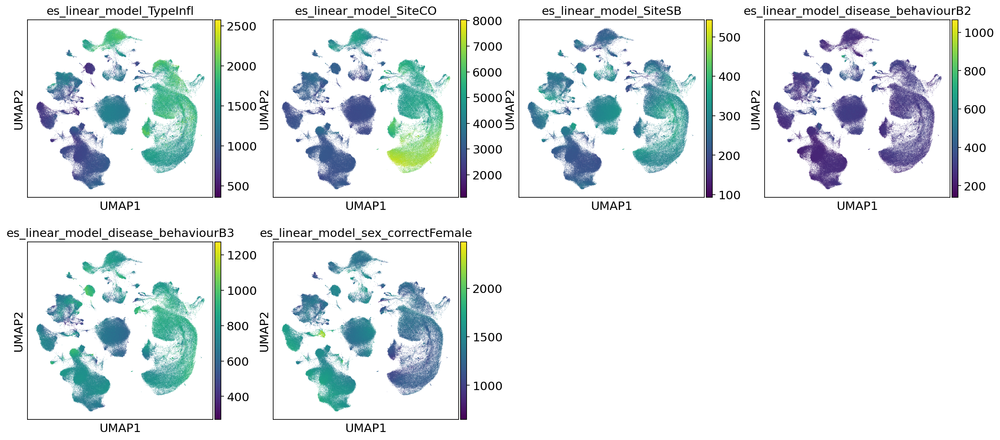

In [11]:
for i in linear_model_all.coords['covariate'].values:
    print(i)
    subset_biopsy.obs[f'es_linear_model_{i}'] = linear_model_all.sel({'covariate': i}).effect_size.values.flatten()
    
sc.pl.umap(subset_biopsy, color=subset_biopsy.obs.filter(regex=("es_linear_model")).columns)

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


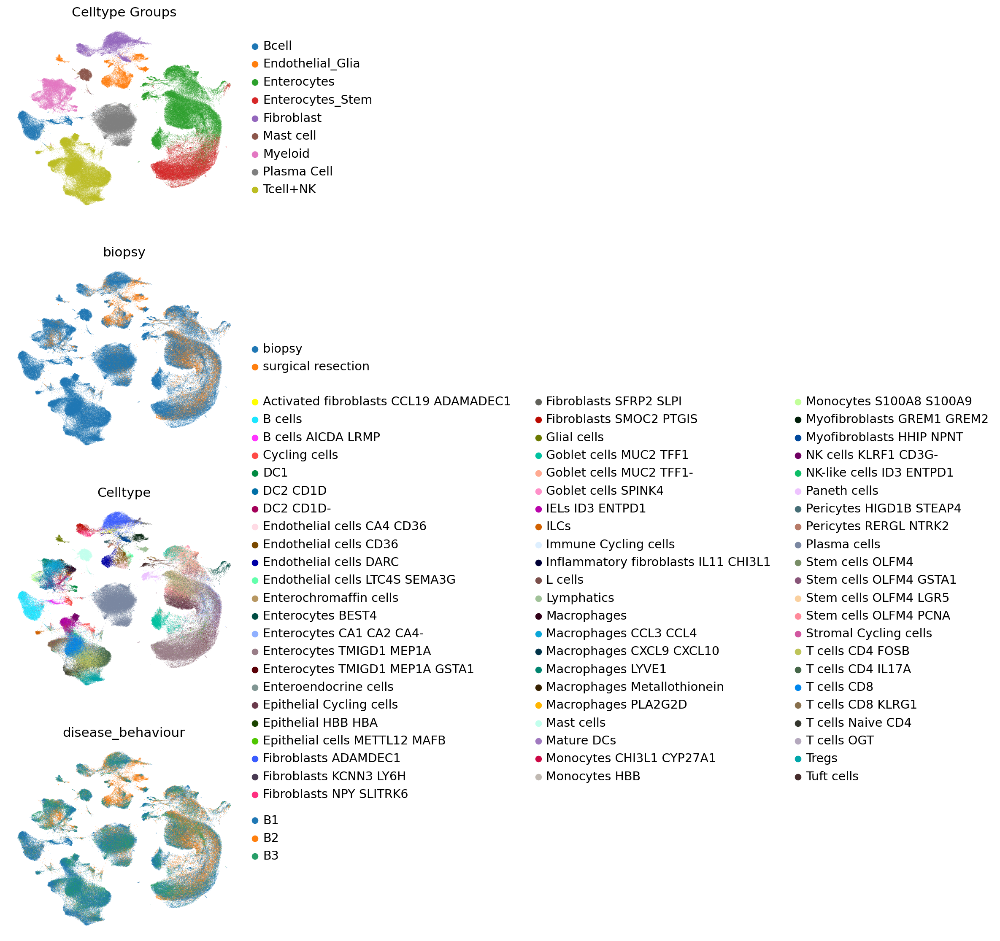

In [12]:
sc.pl.umap(subset, color=['Celltype Groups', 'biopsy', 'Celltype', 'disease_behaviour'],
       frameon=False, save='subset_meta.svg',
       cmap='seismic',
       vmax=5, vmin=-5,
       use_raw=False,
       ncols=1)

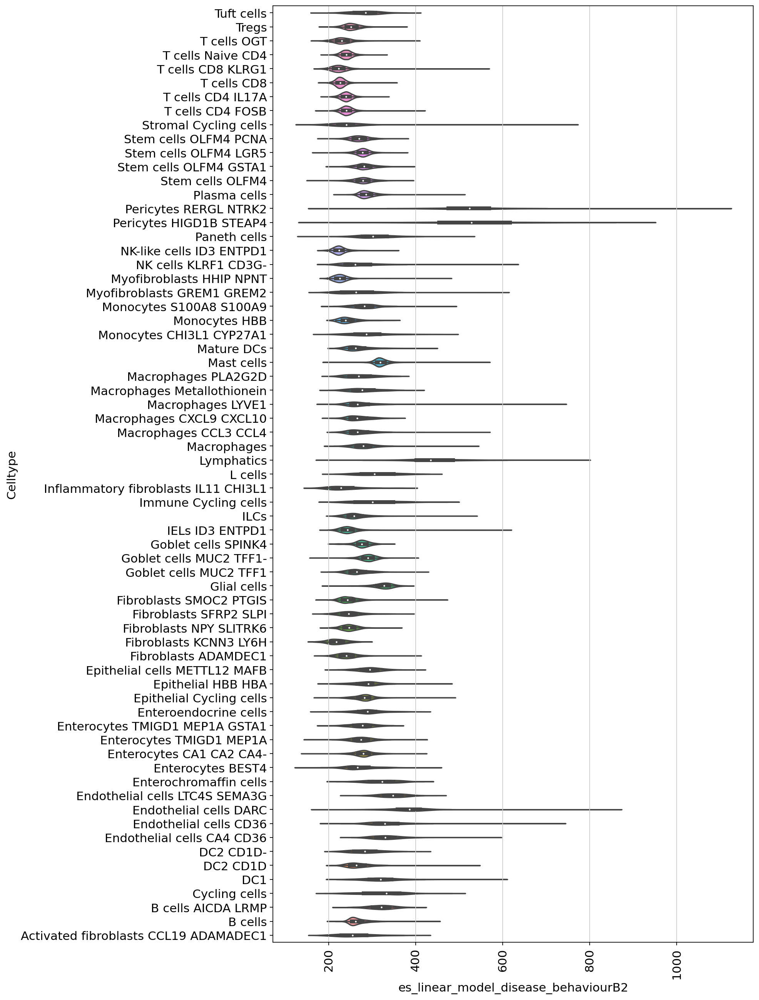

In [42]:
df = subset_biopsy.obs

# Create the violin plot
plt.figure(figsize=(10, 20))
ax = sns.violinplot(x='es_linear_model_disease_behaviourB2', y='Celltype', data=df)

# Swap the axes
ax.invert_yaxis()
plt.xticks(rotation=90)
# Show the plot
plt.savefig('b2_effect_size_violin.svg')
plt.show()


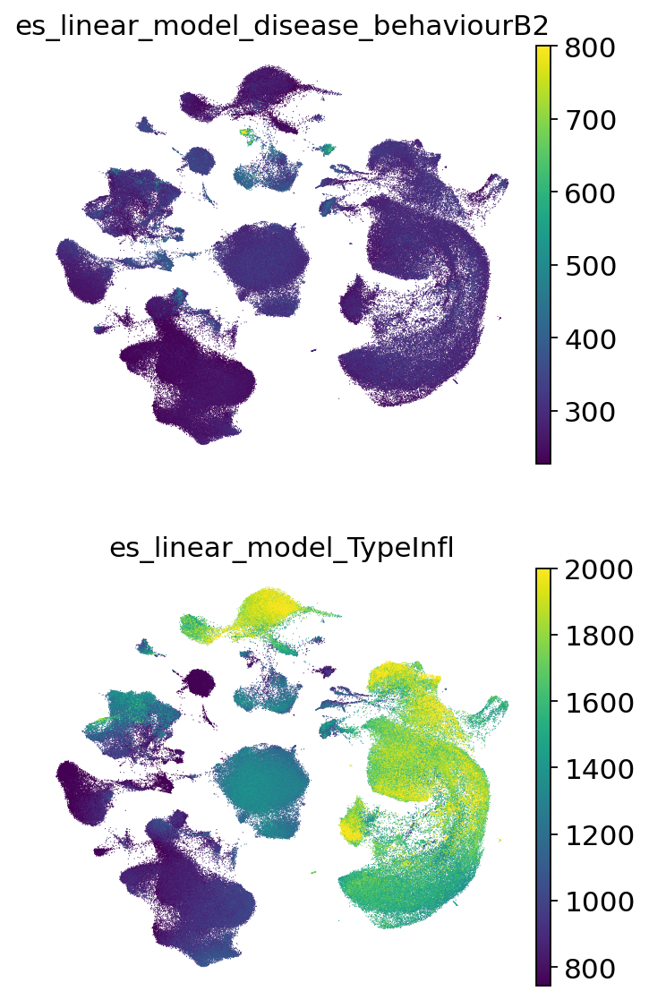

In [14]:
sc.pl.umap(subset_biopsy, color=['es_linear_model_disease_behaviourB2', 'es_linear_model_TypeInfl'],
       frameon=False, save='biopsy_meta.svg',
       cmap='viridis',
       vmax=[800, 2000], vmin='p10',
       use_raw=False,
       size=1,
       ncols=1)

In [15]:
cell_counts = subset_biopsy[subset_biopsy.obs['Celltype Groups'].isin(['Endothelial_Glia', 'Fibroblast'])].obs['Celltype'].value_counts()
# Identify cell types with fewer than 100 cells
small_cell_types = cell_counts[cell_counts > 100].index

# Filter out these cell types from the AnnData object
sub_ = subset_biopsy[subset_biopsy.obs['Celltype'].isin(small_cell_types)].copy()

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


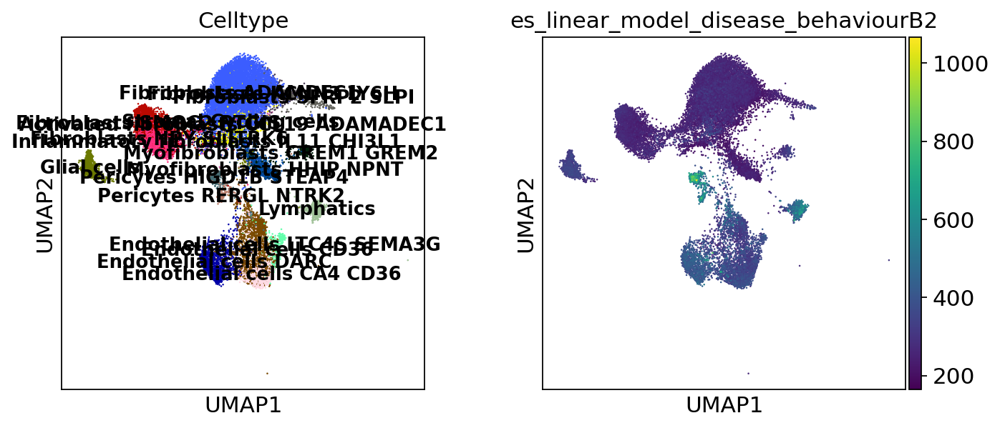

In [16]:
sc.pl.umap(sub_, color=['Celltype', 'es_linear_model_disease_behaviourB2'], legend_loc='on data', legend_fontsize='small')

In [17]:
subset_biopsy.obs['Celltype Grouped'] = subset_biopsy.obs['Celltype Groups'].astype(str)
subset_biopsy.obs.loc[subset_biopsy.obs['Celltype Groups'].isin(['Endothelial_Glia', 'Fibroblast']), 'Celltype Grouped'] = 'Stroma'

In [18]:
fibroblast_b2_mrvi = sc.read('export_adata_biopsy/adata_disease_behaviour_B2_biopsy_Stroma.h5ad')

In [19]:
cell_counts = fibroblast_b2_mrvi.obs['Celltype'].value_counts()
# Identify cell types with fewer than 100 cells
small_cell_types = cell_counts[cell_counts < 100].index

# Filter out these cell types from the AnnData object
fibroblast_b2_mrvi_filtered = fibroblast_b2_mrvi[~fibroblast_b2_mrvi.obs['Celltype'].isin(small_cell_types)].copy()
fibroblast = subset[fibroblast_b2_mrvi_filtered.obs_names]

In [20]:
fibroblast.obs['diff_abundance'] = fibroblast_b2_mrvi_filtered.obs['diff_abundance']

/tmp/ipykernel_293749/2922655397.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  fibroblast.obs['diff_abundance'] = fibroblast_b2_mrvi_filtered.obs['diff_abundance']


In [21]:
sc.pp.filter_genes(fibroblast, min_cells=300)

In [22]:
fibroblast.layers['lfc_b2_behaviour'] = linear_model_all.sel({
    'covariate': 'disease_behaviourB2',
    'cell_name': fibroblast.obs_names}).lfc.to_pandas()[fibroblast.var_names].values

In [23]:
sc.pp.neighbors(fibroblast, n_neighbors=30, use_rep='X_mrvi_u')

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [24]:
fibroblast.obsp['normalized_connectivities'] = fibroblast.obsp['connectivities']/fibroblast.obsp['connectivities'].sum(1)
fibroblast.layers['smoothed_neighbors_lfcs'] = np.asarray(
    fibroblast.obsp['normalized_connectivities'] * fibroblast.obsp['normalized_connectivities'] * fibroblast.layers['lfc_b2_behaviour'])
fibroblast.obs['smoothed_diff_abundance'] = np.asarray(
    fibroblast.obsp['normalized_connectivities'] * fibroblast.obsp['normalized_connectivities'] * np.expand_dims(fibroblast.obs['diff_abundance'], 1))

In [25]:
fibroblast.obs['endothelial_cells'] = np.logical_or(fibroblast.obs['Celltype'].str.startswith('Endothelial cells'),
                                                    fibroblast.obs['Celltype'].str.startswith('Pericytes')).astype(str)
fibroblast.obs['fibroblast'] = fibroblast.obs['Celltype'].str.contains('ibroblast').astype(str)

In [26]:
sc.set_figure_params(vector_friendly=True, dpi_save=600)
plt.rcParams['pdf.fonttype'] = 'truetype'
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['pdf.use14corefonts'] = True 

In [27]:
sc.tl.leiden(fibroblast, resolution=1.6)

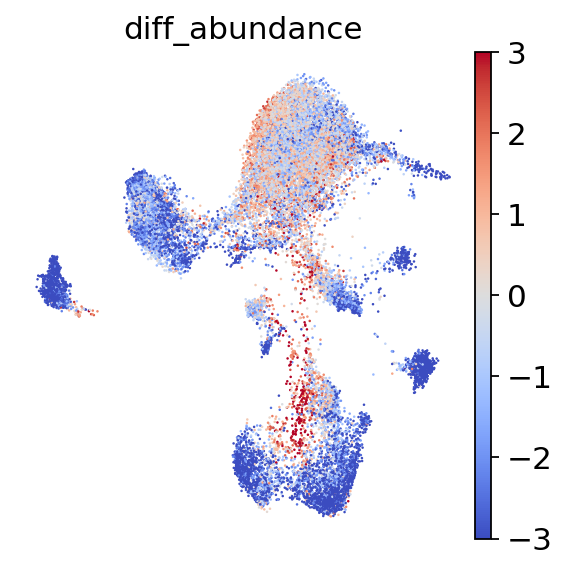

In [28]:
sc.pl.umap(fibroblast, color=['diff_abundance'],
       frameon=False, save='abundance.svg',
       cmap='coolwarm',
       vmax=3, vmin=-3,
       use_raw=False,
       sort_order=False,
       ncols=1)

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


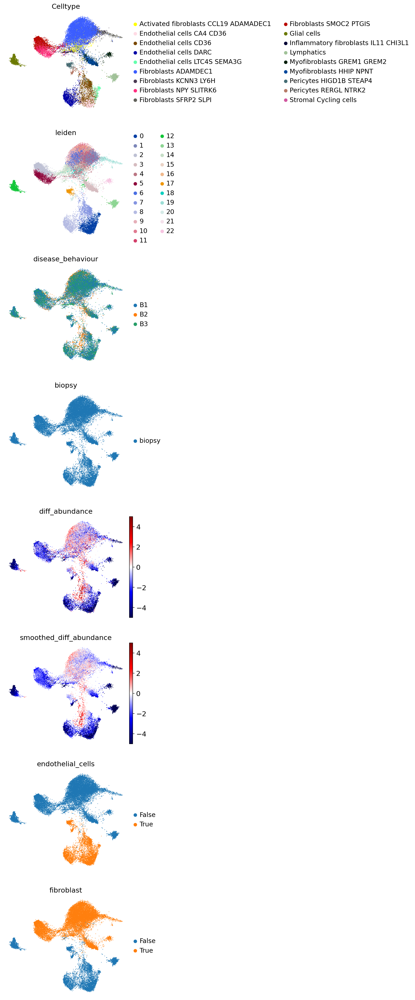

In [29]:
sc.pl.umap(fibroblast, color=['Celltype', 'leiden', 'disease_behaviour', 'biopsy', 'diff_abundance', 'smoothed_diff_abundance', 'endothelial_cells', 'fibroblast'],
       frameon=False, save='stromal_metadata.svg',
       cmap='seismic',
       vmax=5, vmin=-5,
       use_raw=False,
       sort_order=False,
       ncols=1)

In [30]:
fibroblast.obs['es_linear_model_disease_behaviourB2'] = subset_biopsy.obs.loc[
    fibroblast.obs_names, ['es_linear_model_disease_behaviourB2']]
fibroblast.obs['es_linear_model_TypeInfl'] = subset_biopsy.obs.loc[
    fibroblast.obs_names, ['es_linear_model_TypeInfl']]

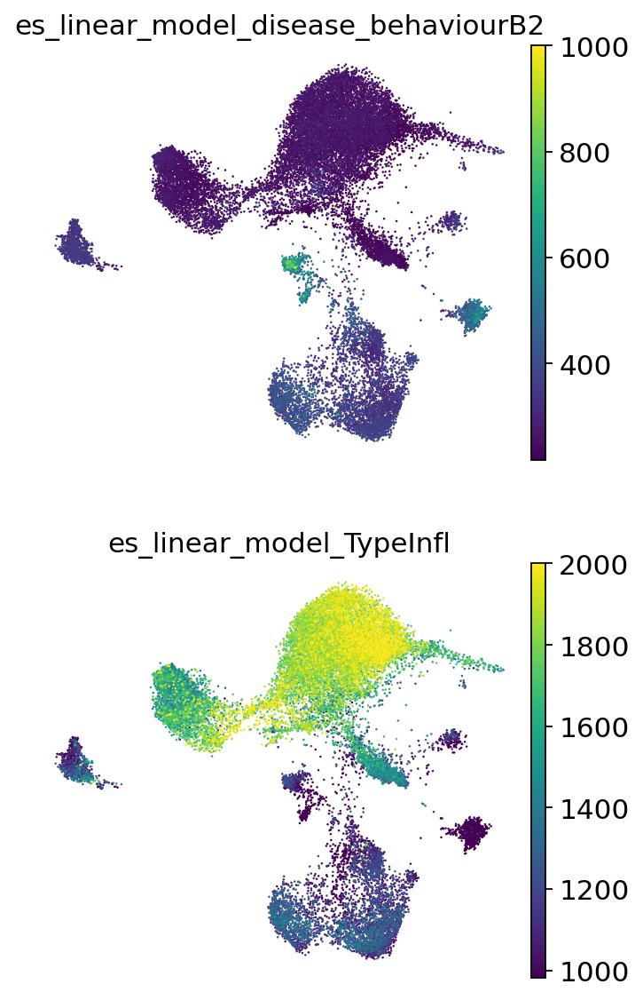

In [31]:
sc.pl.umap(fibroblast, color=['es_linear_model_disease_behaviourB2', 'es_linear_model_TypeInfl'],
       frameon=False, save='stromal_es.svg',
       cmap='viridis',
       vmax=[1000, 2000], vmin='p10',
       use_raw=False,
       ncols=1)

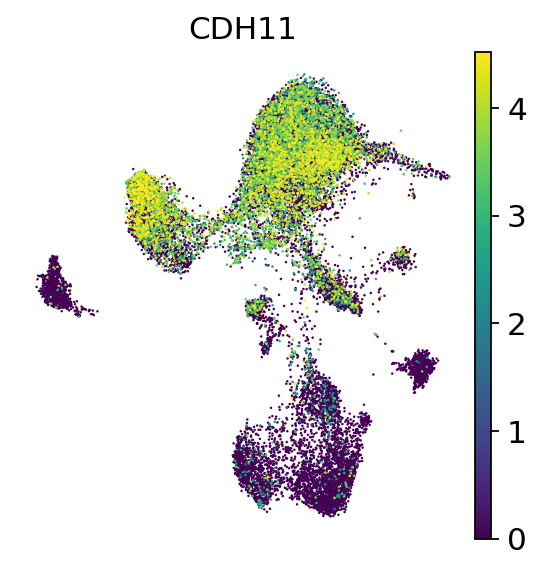

In [32]:
gene = 'CDH11'
sc.pl.umap(fibroblast, color=[gene], frameon=False, sort_order=True, size=5,
       save='stromal_cdh11.svg',
       use_raw=False,
       vmax='p98',
       ncols=1)

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


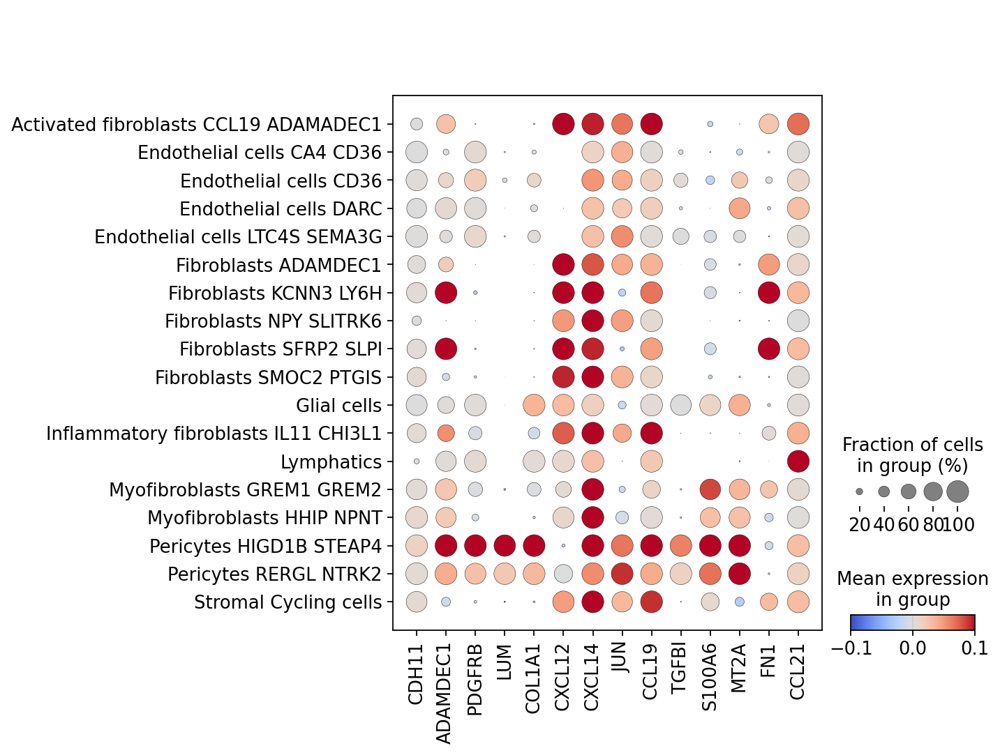

In [33]:
sc.pl.dotplot(fibroblast,
           var_names=['CDH11', 'ADAMDEC1', 'PDGFRB', 'LUM', 'COL1A1', 'CXCL12', 'CXCL14', 'JUN', 'CCL19', 'TGFBI', 'S100A6', 'MT2A', 'FN1', 'CCL21'],
           groupby='Celltype', layer='smoothed_neighbors_lfcs', save='lfc_gene.pdf', cmap='coolwarm', vcenter=0, vmax=0.1, vmin=-0.1)

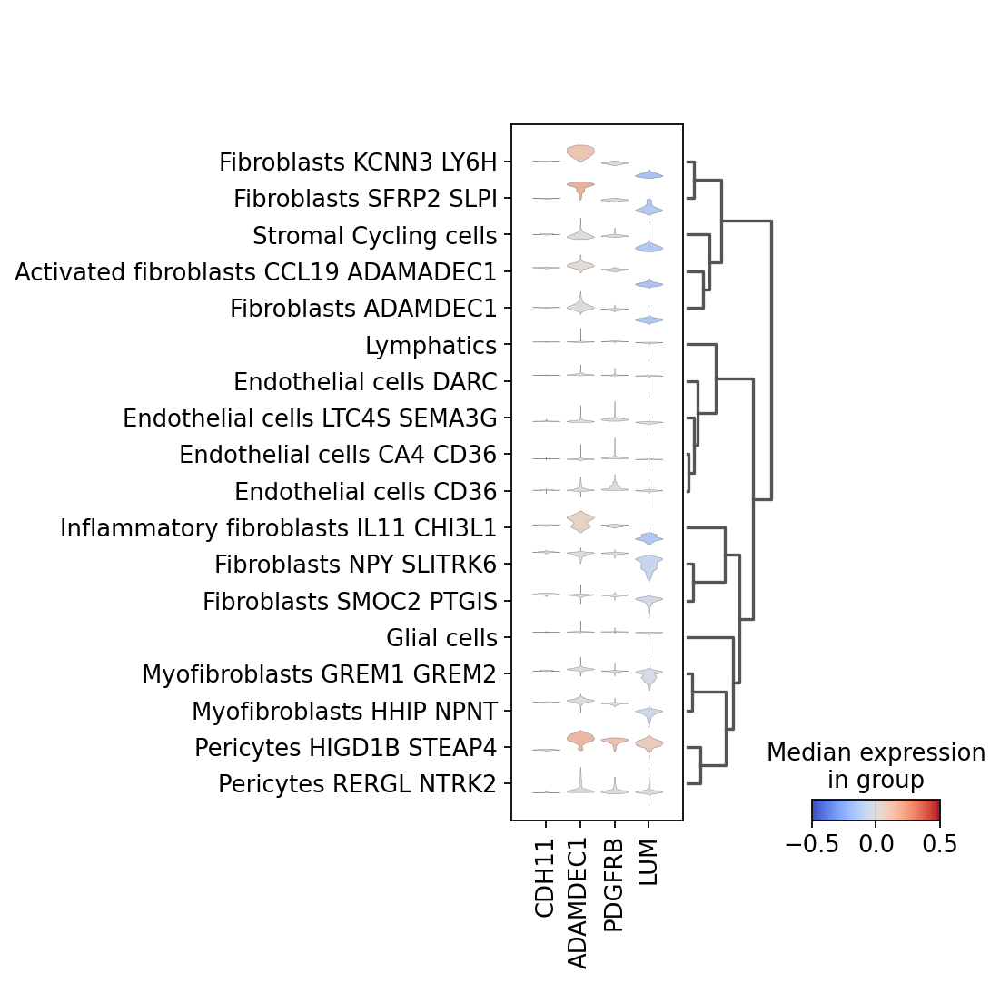

In [63]:
sc.pl.stacked_violin(fibroblast,
           var_names=['CDH11', 'ADAMDEC1', 'PDGFRB', 'LUM'],
           dendrogram=True, vcenter=0, cmap='coolwarm', vmax=0.5, vmin=-0.5,
           groupby='Celltype', layer='smoothed_neighbors_lfcs', save='lfc_gene_sub.pdf')

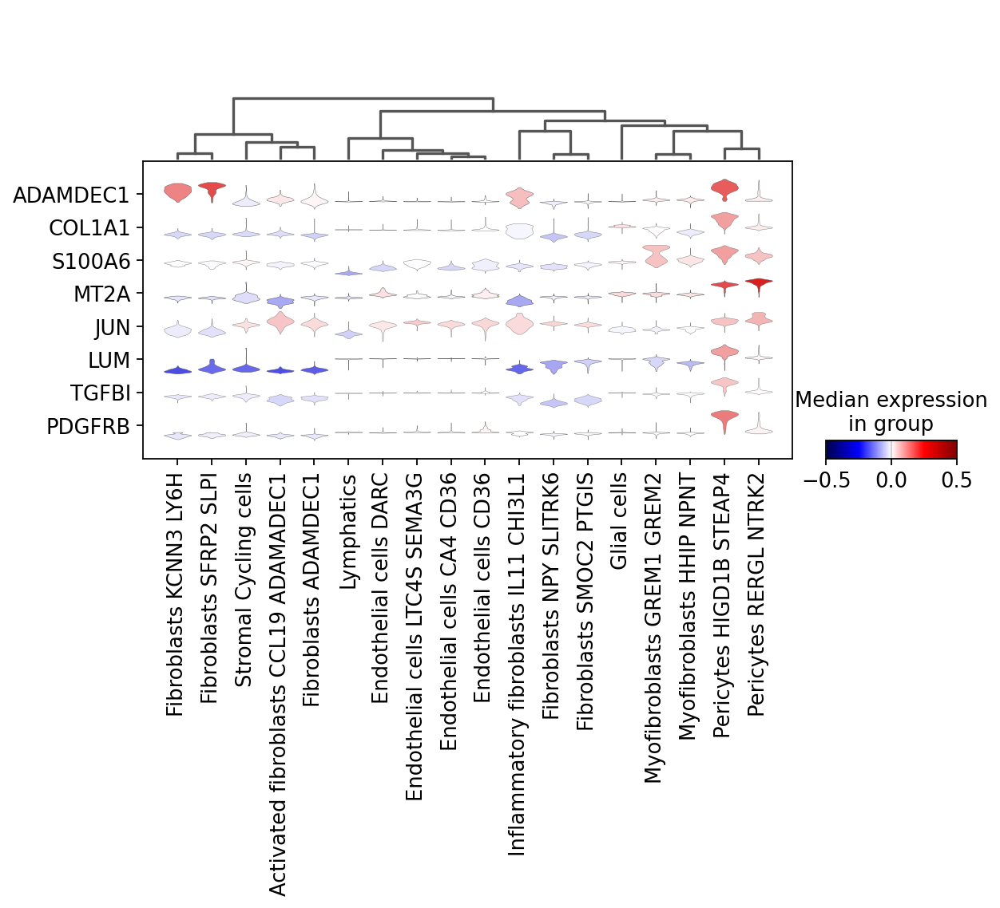

In [41]:
sc.pl.stacked_violin(fibroblast,
           var_names=['ADAMDEC1', 'COL1A1', 'S100A6', 'MT2A', 'JUN', 'LUM', 'TGFBI', 'PDGFRB'],
           dendrogram=True, vcenter=0, cmap='seismic', vmax=0.5, vmin=-0.5, swap_axes=True, rotation=45,
           groupby='Celltype', layer='smoothed_neighbors_lfcs', save='lfc_gene.svg')

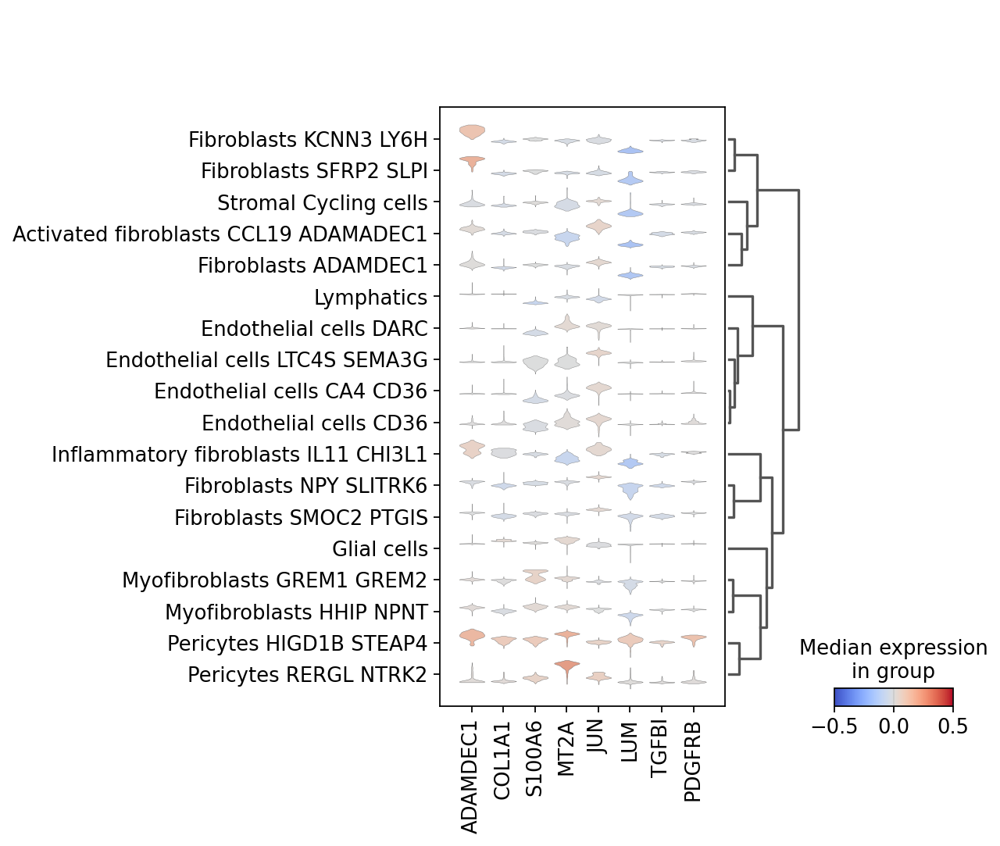

In [36]:
sc.pl.stacked_violin(fibroblast,
           var_names=['ADAMDEC1', 'COL1A1', 'S100A6', 'MT2A', 'JUN', 'LUM', 'TGFBI', 'PDGFRB'],
           dendrogram=True, vcenter=0, cmap='coolwarm', vmax=0.5, vmin=-0.5,
           groupby='Celltype', layer='smoothed_neighbors_lfcs', save='lfc_gene.pdf')

array([ 0.00091305,  0.00243137, -0.00219102, ..., -0.00388048,
       -0.00216082,  0.00058342], dtype=float32)

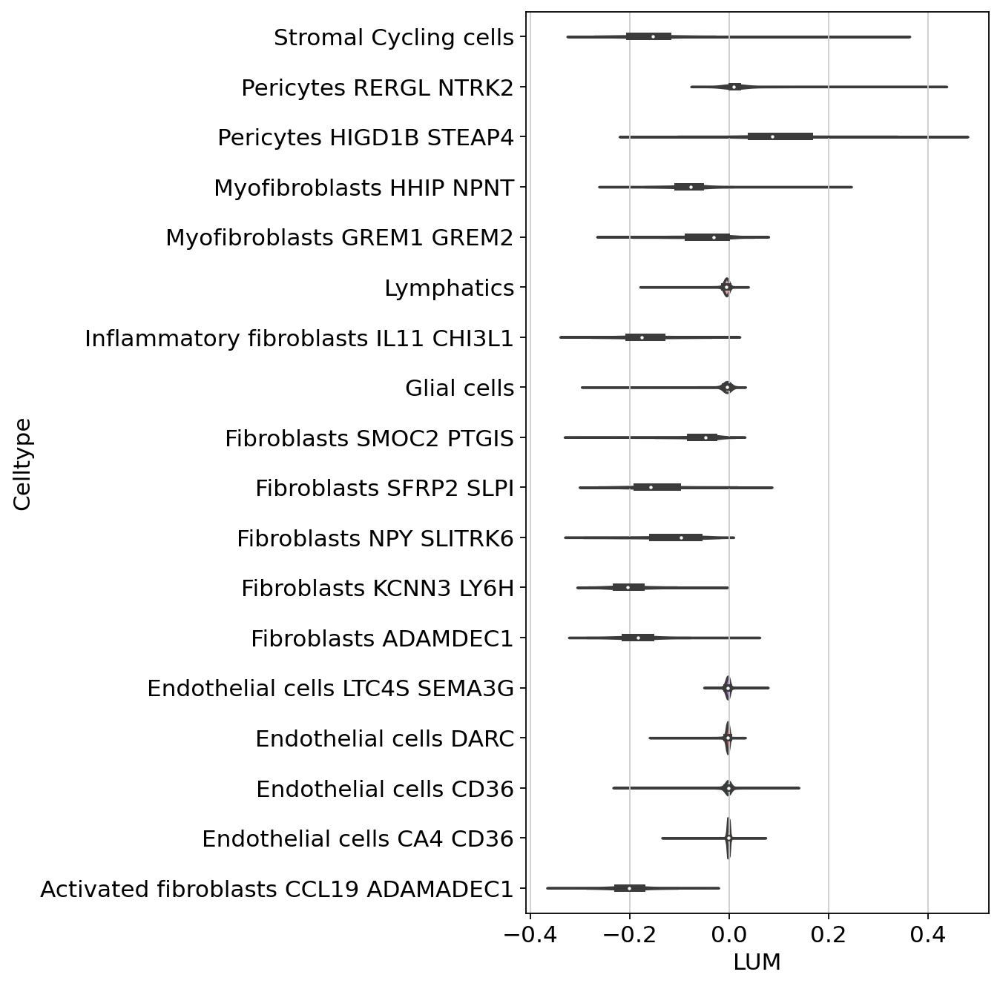

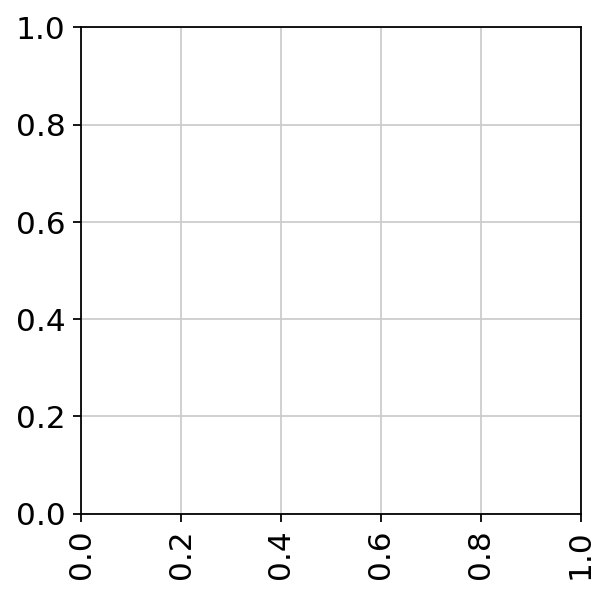

In [77]:
df = fibroblast.obs
df['LUM'] = np.array(fibroblast[:, 'LUM'].layers['smoothed_neighbors_lfcs'].squeeze())

# Create the violin plot
plt.figure(figsize=(5, 10))
ax = sns.violinplot(x='LUM', y='Celltype', data=df)

# Swap the axes
ax.invert_yaxis()
plt.show()
plt.xticks(rotation=90)
plt.title
# Show the plot
#plt.savefig('b2_effect_size_violin.svg')
plt.show()


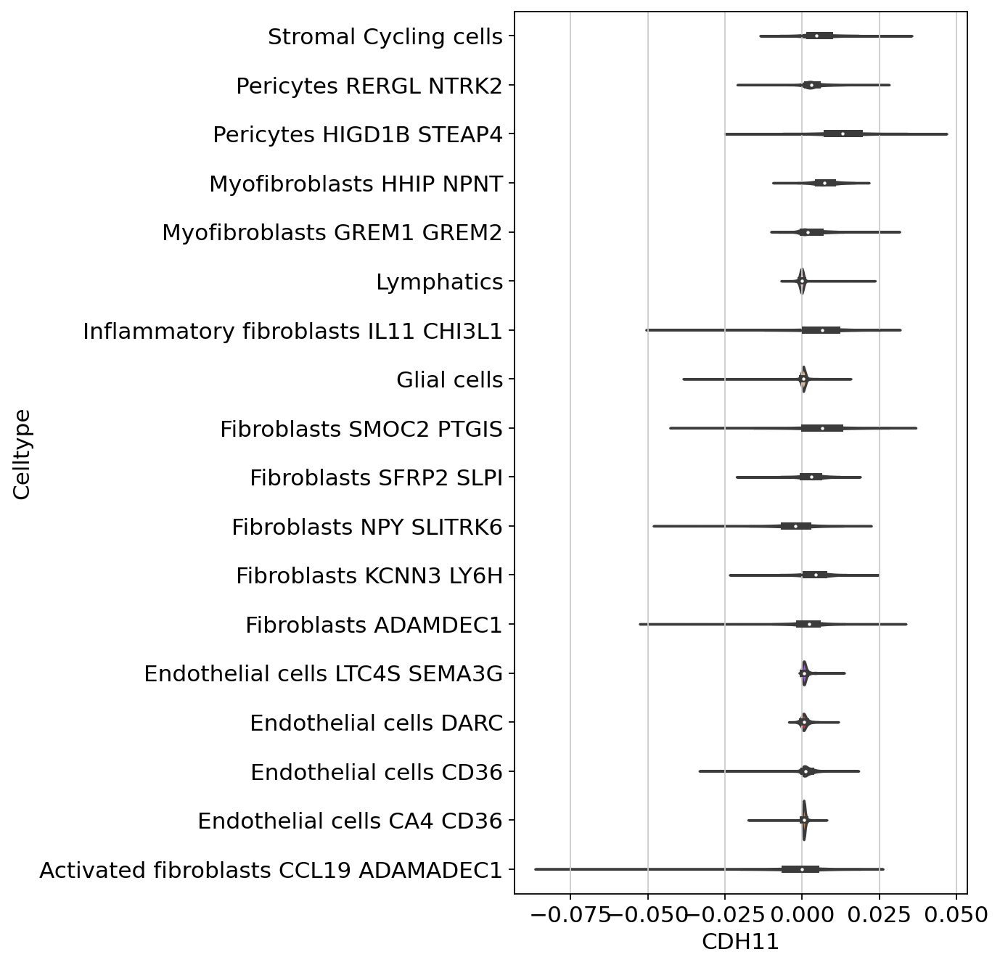

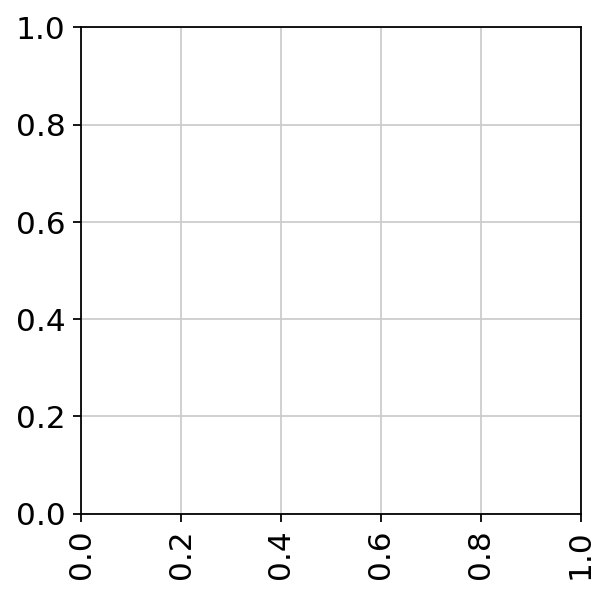

In [78]:
df = fibroblast.obs
df['CDH11'] = np.array(fibroblast[:, 'CDH11'].layers['lfc_b2_behaviour'].squeeze())

# Create the violin plot
plt.figure(figsize=(5, 10))
ax = sns.violinplot(x='CDH11', y='Celltype', data=df)

# Swap the axes
ax.invert_yaxis()
plt.show()
plt.xticks(rotation=90)
plt.title
# Show the plot
#plt.savefig('b2_effect_size_violin.svg')
plt.show()


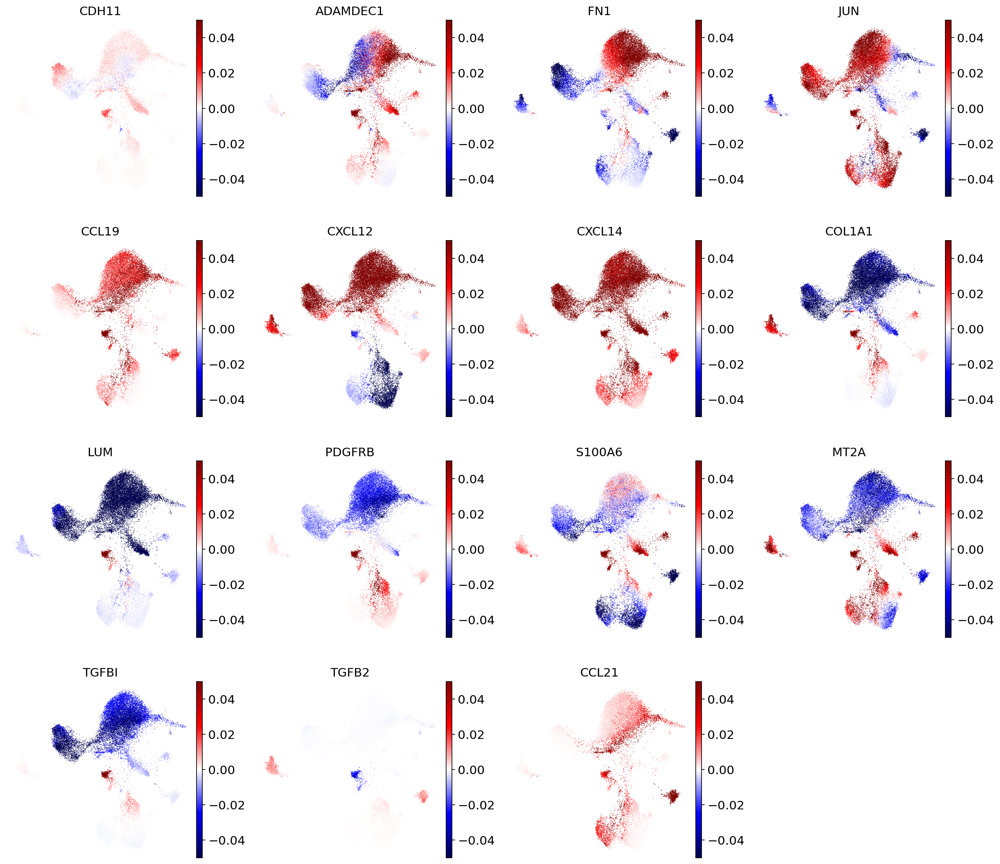

In [40]:
sc.pl.umap(fibroblast,
           color=['CDH11', 'ADAMDEC1', 'FN1', 'JUN', 'CCL19', 'CXCL12', 'CXCL14', 'COL1A1', 'LUM', 'PDGFRB', 'S100A6', 'MT2A', 'TGFBI', 'TGFB2', 'CCL21'],
           ncols=4, vcenter=0, vmin=-0.05, vmax=0.05, frameon=False, size=2, sort_order=False, cmap='seismic', layer='smoothed_neighbors_lfcs', save='lfc_gene.svg')

In [41]:
from sklearn.covariance import LedoitWolf
cov2 = LedoitWolf().fit(fibroblast.layers['smoothed_neighbors_lfcs'])

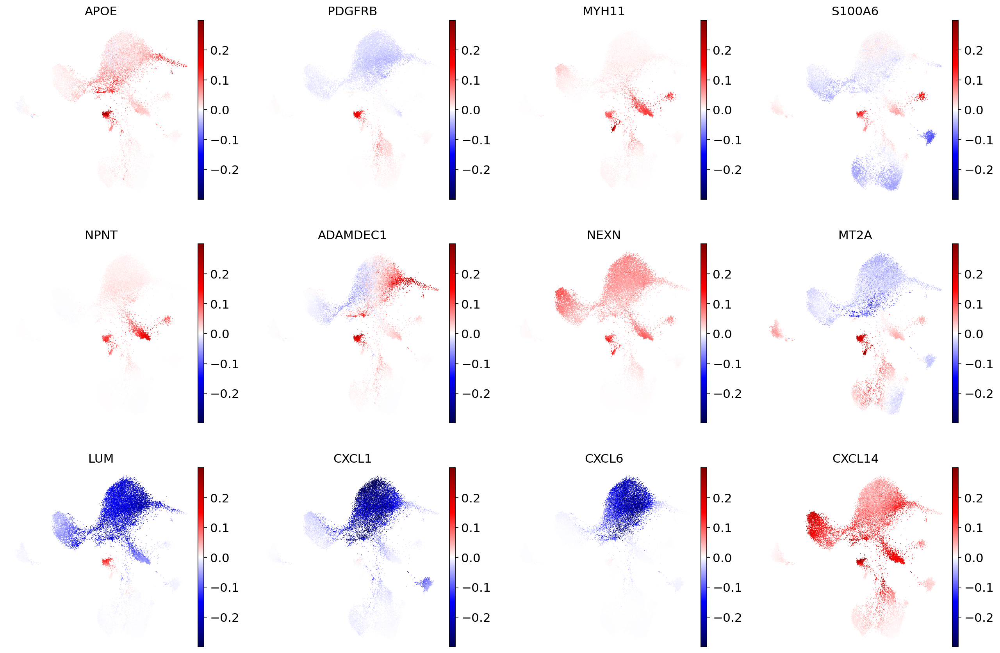

In [42]:
sc.pl.umap(fibroblast,
           color=fibroblast.var_names[np.argsort(cov2.covariance_[int(np.where(fibroblast.var_names=='CDH11')[0]), :])[-12:]],
           ncols=4, vcenter=0, vmin=-0.3, vmax=0.3, frameon=False, size=2, sort_order=False, cmap='seismic', layer='smoothed_neighbors_lfcs')#, save='lfc_12best.png')

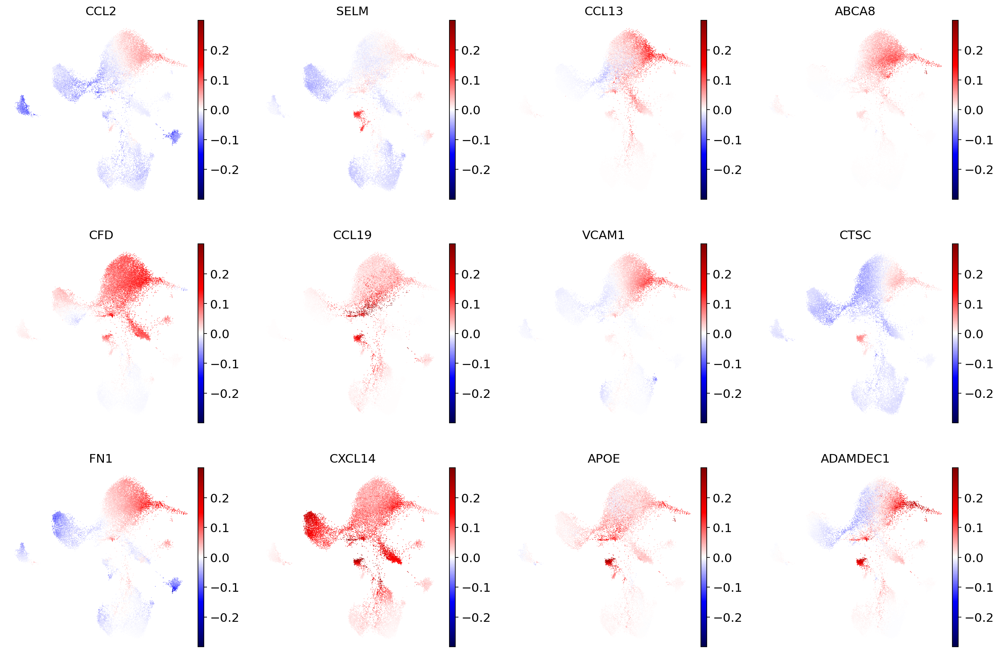

In [43]:
sc.pl.umap(fibroblast,
           color=fibroblast.var_names[np.argsort(cov2.covariance_[int(np.where(fibroblast.var_names=='ADAMDEC1')[0]), :])[-12:]],
           ncols=4, vcenter=0, vmin=-0.3, vmax=0.3, frameon=False, size=2, sort_order=False, cmap='seismic', layer='smoothed_neighbors_lfcs')#, save='lfc_12best.png')

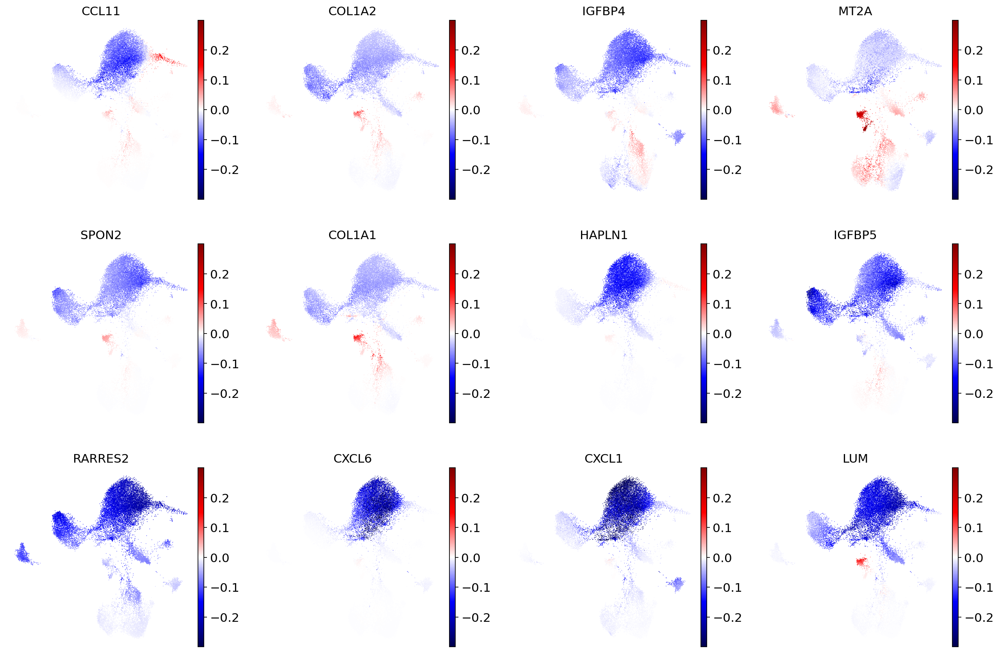

In [44]:
sc.pl.umap(fibroblast,
           color=fibroblast.var_names[np.argsort(cov2.covariance_[int(np.where(fibroblast.var_names=='COL1A1')[0]), :])[-12:]],
           ncols=4, vcenter=0, vmin=-0.3, vmax=0.3, frameon=False, size=2, sort_order=False, cmap='seismic', layer='smoothed_neighbors_lfcs')#, save='lfc_12best.png')

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


         Falling back to preprocessing with `sc.pp.pca` and default params.


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


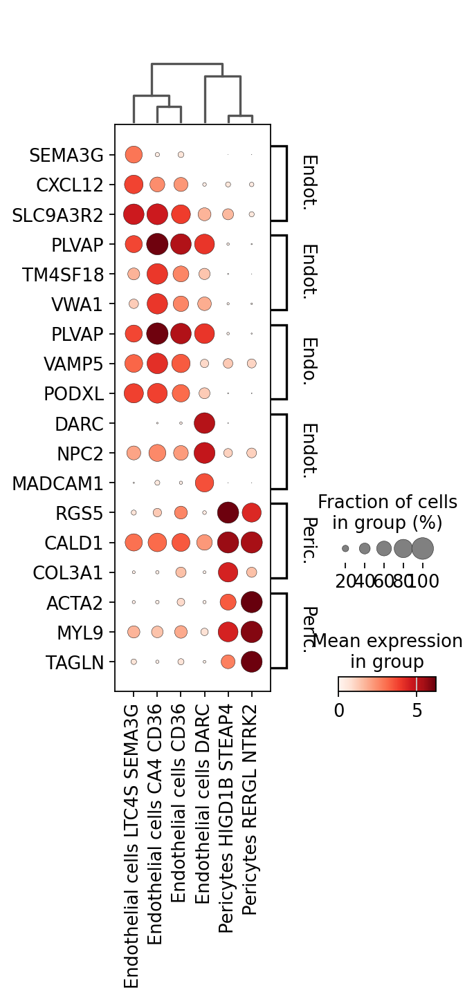

In [32]:
endothelial = fibroblast[fibroblast.obs['endothelial_cells']=='True']
sc.tl.rank_genes_groups(endothelial, groupby='Celltype')
sc.pl.rank_genes_groups_dotplot(endothelial, min_logfoldchange=1., n_genes=3, swap_axes=True, var_group_rotation=90, save='markers_endothelial.svg')

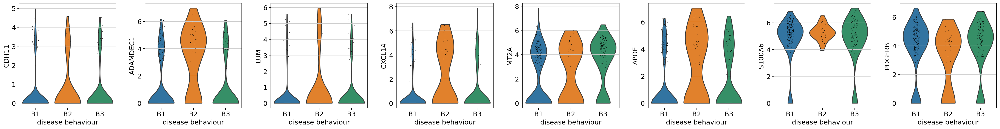

In [33]:
sc.pl.violin(fibroblast[fibroblast.obs['Celltype']=='Pericytes HIGD1B STEAP4'],
             keys=['CDH11', 'ADAMDEC1', 'LUM', 'CXCL14', 'MT2A', 'APOE', 'S100A6', 'PDGFRB'],
             groupby='disease_behaviour',
             frameon=False, use_raw=False, ncols=4,
             save='pericyte_genes.svg',
             swap_axes=True)

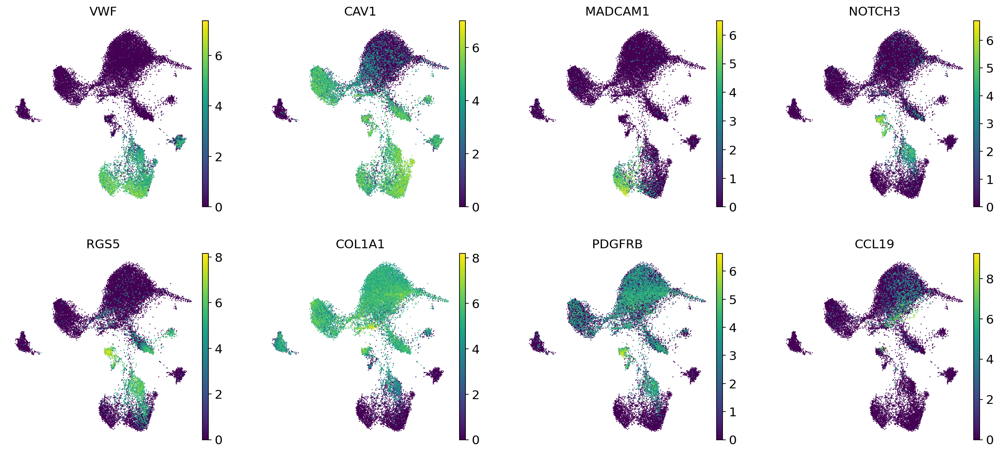

In [34]:
sc.pl.umap(fibroblast, color=['VWF', 'CAV1', 'MADCAM1', 'NOTCH3', 'RGS5', 'COL1A1', 'PDGFRB', 'CCL19'], frameon=False,
       use_raw=False,
       ncols=4,
       save='endothelial_to_mesnechymal_genes.svg')

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


         Falling back to preprocessing with `sc.pp.pca` and default params.


/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


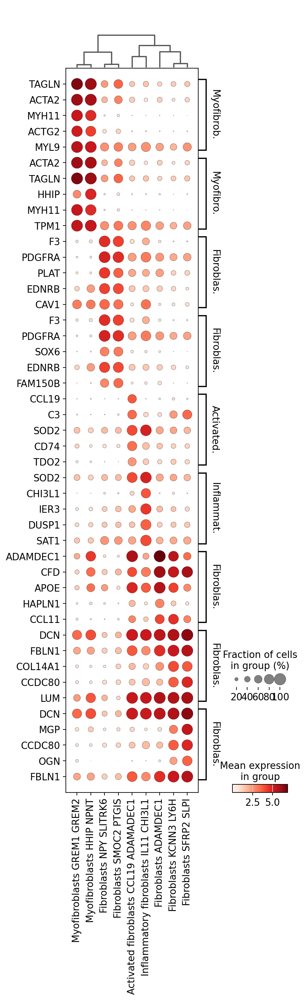

In [35]:
fibroblast_sub = fibroblast[fibroblast.obs['fibroblast']=='True']
sc.tl.rank_genes_groups(fibroblast_sub, groupby='Celltype')
sc.pl.rank_genes_groups_dotplot(fibroblast_sub, min_logfoldchange=1., n_genes=5, swap_axes=True, var_group_rotation=90, save='markers_fibroblast.svg')

/data/yosef3/users/can/conda/envs/mrvi_v4/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


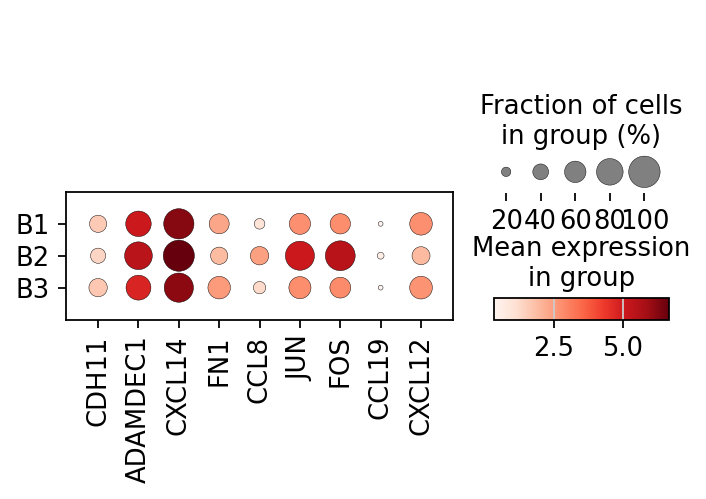

In [36]:
sc.pl.dotplot(fibroblast_sub, var_names=['CDH11', 'ADAMDEC1', 'CXCL14', 'FN1', 'CCL8', 'JUN', 'FOS', 'CCL19', 'CXCL12'],
              groupby='disease_behaviour', save='differential_expression_fibroblast.pdf')

In [ ]:
fibroblast.write_h5ad('stromal_finished_pierre.h5ad')

In [ ]:
#abundance = mrvi_model.get_outlier_cell_sample_pairs(adata=mrvi_model.adata[fibroblast_b2_mrvi.obs_names], flavor = "ap", quantile_threshold = 0.0)
#abundance.to_netcdf('abundance_fibroblast_sub.nc')

# Differential abundance

In [7]:
import xarray as xr

# Open the NetCDF file
abundance = xr.open_dataset('abundance_fibroblast_sub.nc')

In [8]:
fibroblast_sub = sc.read('export_adata_biopsy/adata_disease_behaviour_B2_biopsy_Stroma.h5ad')

In [9]:
pd.options.display.max_rows = 300

In [10]:
abundance_df = abundance.log_probs.to_pandas()

In [11]:
abundance_df

sample,I117351_L,N124246_E,N124246_L,N128208_L,N128624_E,I114902_N,N114902_N,I130084_E,I130084_L,N130084_L,...,N189696_L,N125985_L1,N125985_L2,N171336_L1,N171336_L2,N119540_L1,N119540_L2,N172428_E2,N148519_E1,N168051_E1
cell_name,,,,,,,,,,,,,,,,,,,,,
I117351_L-TTTCAGTAGGGCCAAT,1.186477,-366.821014,-48.163826,-172.607468,-326.972778,-109.068466,-111.563774,-489.162903,-14.215385,-166.020401,...,-122.984184,-196.702560,-106.946007,-183.370239,-151.729568,-146.375778,-201.034302,-184.525757,-1005.736511,-445.663239
N124246_E-GCTGGGTTCTAGTGTG,-37.815731,32.282345,-12.396748,-38.116360,-53.255341,-8.240870,-7.038061,-22.774706,-4.322510,-9.931810,...,-34.015228,-27.469450,-19.091866,0.885409,-52.878433,-10.019772,3.954619,1.036573,-118.623878,-21.661133
N124246_L-AAAGGATTCTCTGCCA,-45.019451,10.696341,-7.246192,-66.587143,-72.461151,-12.243730,-11.572798,-11.218716,-8.869614,-8.346500,...,-39.371201,-43.082756,-21.216003,-9.450659,-89.374687,-10.189491,8.174652,-10.554054,-105.809898,-54.942947
N128208_L-CCTAACCGTGGTATGG,2.021531,-327.865753,4.584721,6.014576,-151.576477,3.534791,2.250328,-30.797997,7.246965,6.778336,...,-2.846309,4.172765,-2.365744,5.382836,7.076420,4.145064,1.422408,-212.803116,-1379.607788,-360.540924
N128208_L-GCCAGTGGTTGGTGTT,8.963052,-435.897644,3.175723,8.121243,-198.371155,7.412826,7.454132,-91.084541,6.479562,7.603365,...,2.534737,6.287350,5.599751,7.571733,9.228127,7.724388,8.338122,-219.122574,-1621.577271,-516.962463
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N168051_E1-CGAGGAACACACACGC,-22.460958,-36.333046,-20.419682,-42.885731,-21.442146,-19.051338,-11.709634,-14.407541,-12.457872,-19.637201,...,-46.482399,-27.986862,-10.449838,-9.842101,-29.195276,-47.324432,5.798708,-54.794926,-147.096069,31.969227
N125985_L2-GAGTCTAAGCAGGTCA,-83.583206,-70.370377,-33.024181,-166.942154,-137.038864,-39.823395,-67.235527,-79.805351,-39.378769,-91.252296,...,-113.455070,-133.960663,-12.111547,-78.196922,-161.699661,-86.634842,-35.063843,-8.310376,-262.351624,-116.776978
N171336_L1-GTTATGGCAACGCATT,-36.683002,-72.496536,-29.293259,-20.878113,-137.077393,-16.589399,-32.793037,-97.549065,-5.656572,-28.508812,...,-97.441574,-27.626017,-48.206711,-0.679908,-13.574486,-35.417267,-14.185330,-78.669670,-533.215454,-179.278854


In [12]:
from scipy.special import logsumexp

In [13]:
from scipy.special import logsumexp
from numpy import mean

def logsummean(x):
        return logsumexp(x) - np.log(x.shape[0])

(0.0, 400.0)

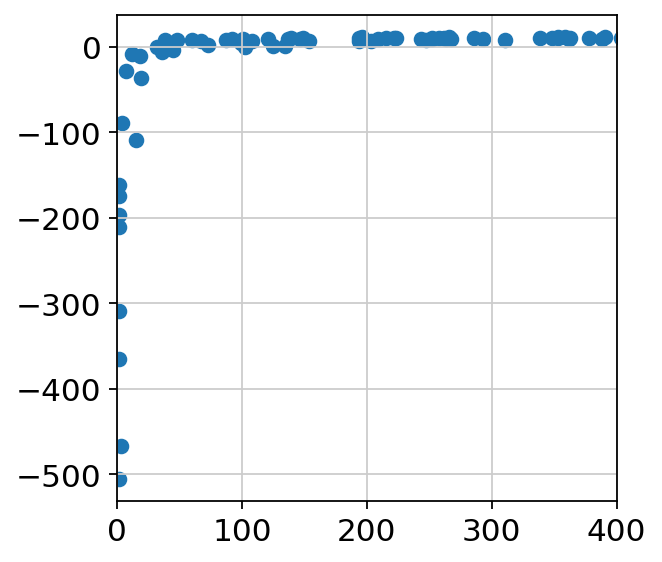

In [30]:
plt.scatter(fibroblast.obs['biosample_id'].value_counts()[list(fibroblast.obs['biosample_id'].unique())], abundance_df[fibroblast.obs['biosample_id'].unique()].apply(mean))
plt.xlim(0, 400)

In [31]:
abundance = abundance_df[fibroblast.obs.groupby('biosample_id').filter(lambda x: len(x) >= 50)['biosample_id'].unique()]
abundance = abundance.filter(like='_L', axis=1)

In [32]:
df = abundance
df_unstacked = df.unstack(level=1)

In [33]:
pd.options.display.max_rows = 300

In [34]:
df_unstacked = df_unstacked.reset_index(level=0)

In [35]:
fibroblast.obs['Celltype'].value_counts()

Fibroblasts ADAMDEC1                     9498
Fibroblasts SMOC2 PTGIS                  2145
Endothelial cells CD36                   2129
Endothelial cells DARC                   1280
Myofibroblasts HHIP NPNT                 1248
Fibroblasts NPY SLITRK6                  1099
Glial cells                              1038
Endothelial cells CA4 CD36                987
Lymphatics                                815
Pericytes HIGD1B STEAP4                   548
Activated fibroblasts CCL19 ADAMADEC1     541
Fibroblasts KCNN3 LY6H                    415
Myofibroblasts GREM1 GREM2                394
Fibroblasts SFRP2 SLPI                    351
Endothelial cells LTC4S SEMA3G            291
Pericytes RERGL NTRK2                     287
Inflammatory fibroblasts IL11 CHI3L1      184
Stromal Cycling cells                     130
Name: Celltype, dtype: int64

In [36]:
fibroblast_sub_ = fibroblast[fibroblast.obs_names.intersection(df_unstacked.index)]
df_subset = df.T
mapping = fibroblast_sub_.obs[['biosample_id', 'disease_behaviour']].drop_duplicates().set_index('biosample_id')['disease_behaviour'].to_dict()
df_subset['sample'] = df_subset.index
df_subset['disease_behaviour'] = [mapping[i] for i in df_subset['sample']]
from scipy.special import logsumexp
from numpy import median, mean, max

# Select only numeric columns
df_numeric = df_subset.select_dtypes(include=[np.number])
# Group by 'disease_behaviour' and compute logsumexp for each column
df_final_ = df_numeric.groupby(df_subset['disease_behaviour']).apply(lambda group: group.apply(logsummean)).T
df_final_ = df_final_.sub(df_final_['B1'], axis=0)

In [37]:
fibroblast_sub_.obs['diff_abundance_new'] = df_final_['B2']

/tmp/ipykernel_4118873/833156309.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  fibroblast_sub_.obs['diff_abundance_new'] = df_final_['B2']


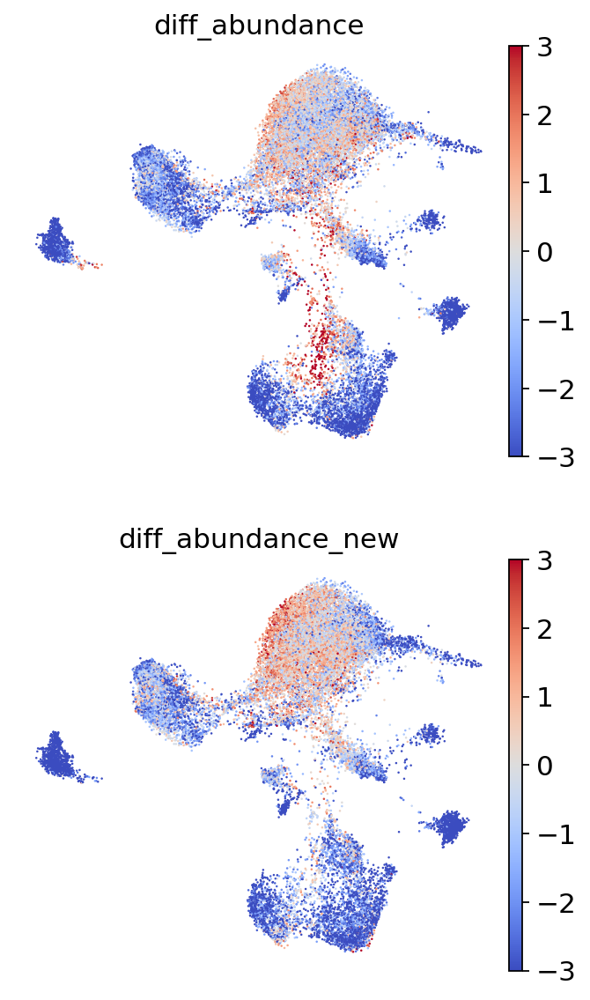

In [49]:
sc.pl.umap(fibroblast_sub_, color=['diff_abundance', 'diff_abundance_new'],
       frameon=False,
       cmap='coolwarm',
       vmax=3, vmin=-3,
       save='filtered_abundance.svg',
       use_raw=False,
       sort_order=False,
       ncols=1)

In [42]:
df_final_

disease_behaviour,B1,B2,B3
cell_name,,,
I117351_L-TTTCAGTAGGGCCAAT,0.0,-47.153078,-14.762782
N124246_E-GCTGGGTTCTAGTGTG,0.0,-11.085377,-3.443414
N124246_L-AAAGGATTCTCTGCCA,0.0,3.733118,1.541391
N128208_L-CCTAACCGTGGTATGG,0.0,-1.850732,-0.109012
N128208_L-GCCAGTGGTTGGTGTT,0.0,-0.632494,-0.947661
...,...,...,...
N168051_E1-CGAGGAACACACACGC,0.0,-11.650294,-2.883071
N125985_L2-GAGTCTAAGCAGGTCA,0.0,-6.447120,12.907370
N171336_L1-GTTATGGCAACGCATT,0.0,-26.416140,-4.322184


In [ ]:
def logsummean(x):
        return logsumexp(x) - np.log(x.shape[0])

differential_abundance = {}

for ind, counts in fibroblast_sub_.obs['Celltype'].value_counts().items():
    if counts < 50:
        print(ind)
        continue
    else:
        print(ind, counts)
    
    df_subset = df.loc[fibroblast_sub_[fibroblast_sub_.obs['Celltype']==ind].obs_names].T
    mapping = fibroblast_sub_.obs[['biosample_id', 'disease_behaviour']].drop_duplicates().set_index('biosample_id')['disease_behaviour'].to_dict()
    df_subset['sample'] = df_subset.index
    df_subset['disease_behaviour'] = [mapping[i] for i in df_subset['sample']]
    from scipy.special import logsumexp
    from numpy import median, mean, max

    # Select only numeric columns
    df_numeric = df_subset.select_dtypes(include=[np.number])
    # Group by 'disease_behaviour' and compute logsumexp for each column
    df_final_ = df_numeric.groupby(df_subset['disease_behaviour']).apply(lambda group: group.apply(logsummean)).T
    df_final_ = df_final_.sub(df_final_['B1'], axis=0)
    differential_abundance[ind] = df_final_['B2']
    df_final = df_final_.melt()

    # Create the swarmplot
    sns.violinplot(x='disease_behaviour', y='value', data=df_final)

    # Set the title and labels
    plt.title('Swarm Plot')
    plt.xlabel('Variable')
    plt.ylabel('Value')
    plt.title(ind)
    plt.ylim(-10, 10)
    plt.xticks(rotation=90)

    # Show the plot
    plt.show()

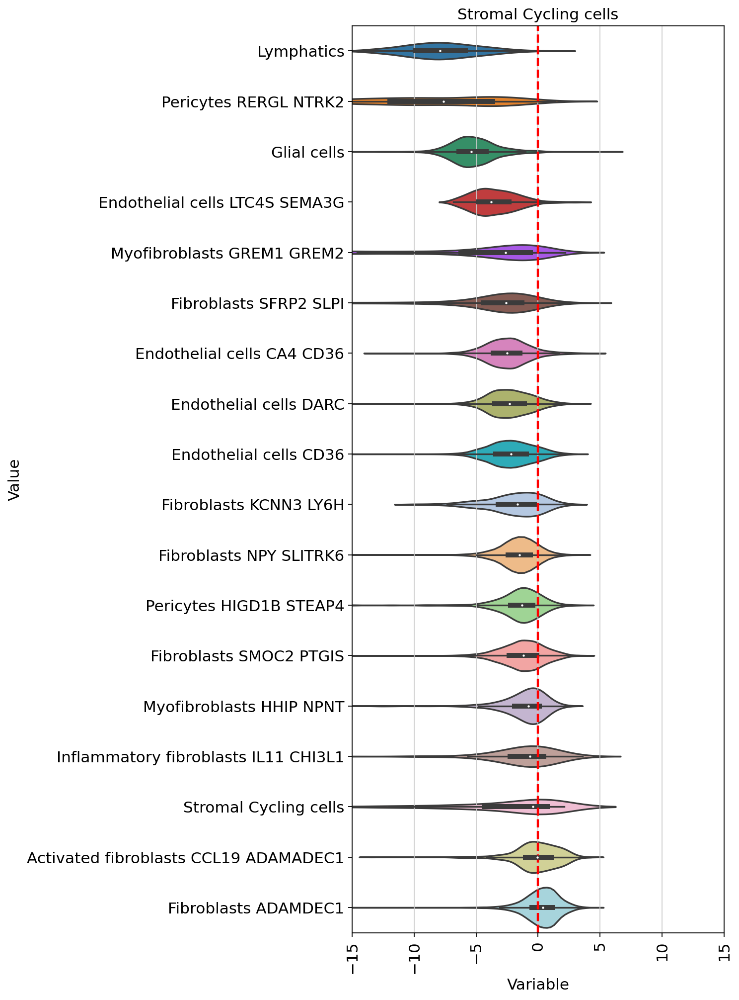

In [44]:
da = pd.DataFrame(differential_abundance)
index_order = da.median(skipna=True, axis=0).sort_values().index
diff_abundance = pd.DataFrame(da[index_order]).melt().dropna()

plt.figure(figsize=(6, 15))
sns.violinplot(x='value', y='variable', data=diff_abundance)
# Set the title and labels
plt.title('Swarm Plot')
plt.xlabel('Variable')
plt.ylabel('Value')
plt.title(ind)
plt.xticks(rotation=90)
plt.xlim(-15, 15)
plt.axvline(0, color='red', linestyle='--', linewidth=2)
# Show the plot
plt.savefig('differential_abundance_fibroblast.svg')
plt.show()

In [45]:
diff_abundance

,variable,value
11,Lymphatics,-4.256976
23,Lymphatics,-4.563462
44,Lymphatics,-4.923779
47,Lymphatics,-5.361732
130,Lymphatics,-1.369209
...,...,...
420831,Fibroblasts ADAMDEC1,-0.100114
420832,Fibroblasts ADAMDEC1,0.848748
420836,Fibroblasts ADAMDEC1,2.427185
420838,Fibroblasts ADAMDEC1,0.457570


In [46]:
from scipy.stats import ttest_ind, ttest_1samp
from statsmodels.stats.multitest import multipletests
from statsmodels.stats.weightstats import ttest_ind as sm_ttest

# Test whether 0 in CIs for each CT
sig_res = (
    diff_abundance
    .groupby("variable")
    .apply(lambda x: ttest_1samp(x["value"], popmean=0)[1])
)
p_adj = multipletests(sig_res, method='fdr_bh')[1]
p_adj = pd.Series(p_adj, index=sig_res.index)
p_adj.sort_values()

variable
Endothelial cells CD36                    0.000000e+00
Glial cells                               0.000000e+00
Lymphatics                                0.000000e+00
Endothelial cells DARC                   2.677967e-262
Endothelial cells CA4 CD36               8.222114e-228
Fibroblasts SMOC2 PTGIS                  1.917335e-196
Fibroblasts NPY SLITRK6                  2.997342e-129
Endothelial cells LTC4S SEMA3G           1.510920e-100
Myofibroblasts HHIP NPNT                  3.220255e-77
Pericytes RERGL NTRK2                     7.590640e-77
Fibroblasts ADAMDEC1                      3.829231e-54
Fibroblasts KCNN3 LY6H                    1.040321e-51
Pericytes HIGD1B STEAP4                   4.063949e-50
Myofibroblasts GREM1 GREM2                1.136756e-47
Fibroblasts SFRP2 SLPI                    1.259835e-41
Stromal Cycling cells                     8.924057e-08
Inflammatory fibroblasts IL11 CHI3L1      7.769303e-06
Activated fibroblasts CCL19 ADAMADEC1     1.263746e-01
d

In [50]:
# Test whether log-ratio sig different for the rest
DELTA = 1.0

comps_sigs = []
cts = index_order
for ct in cts:
    pop1 = diff_abundance.loc[lambda x: x["variable"] == ct]
    pop2 = diff_abundance.loc[lambda x: x["variable"] != ct]
    es0, comps_sig = ttest_ind(pop1["value"], pop2["value"])
    
    es, pval1, df = sm_ttest(pop1["value"], pop2["value"], alternative="larger", value=DELTA)
    es, pval2, df = sm_ttest(pop1["value"], pop2["value"], alternative="smaller", value=-DELTA)
    print(pval1, pval2)
    pval = np.minimum(pval1, pval2)
    
    comps_sigs.append(
        {
            "pval": pval, "es": es0, "ct": ct
        }
    )
comps_sigs = (
    pd.DataFrame(comps_sigs)
    .assign(
        padj=lambda x: multipletests(x["pval"], method='fdr_bh')[1],
        is_sig=lambda x: x["padj"] <= 0.01
    )
)
# comps_sigs = multipletests(comps_sigs, method='fdr_bh')[1]
# comps_sigs = pd.Series(comps_sigs, index=cts)
comps_sigs

1.0 0.0
1.0 7.241541516394903e-232
1.0 4.616546604644957e-222
1.0 3.0556294430307636e-10
1.0 2.717989255617771e-37
1.0 1.6285955850493227e-17
1.0 0.24503281270222893
1.0 0.947364960794792
1.0 0.9885365851545759
1.0 0.9995768693744177
1.0 1.0
1.0 0.9999999999972342
1.0 1.0
0.9999999999999578 1.0
0.9999971969760612 0.9999966537179747
1.0 0.14824892458927064
0.001883571370604498 1.0
0.0 1.0


,pval,es,ct,padj,is_sig
0,0.000000e+00,-68.708520,Lymphatics,0.000000e+00,True
1,7.241542e-232,-38.675012,Pericytes RERGL NTRK2,4.344925e-231,True
2,4.616547e-222,-43.089719,Glial cells,2.077446e-221,True
3,3.055629e-10,-11.882197,Endothelial cells LTC4S SEMA3G,7.857333e-10,True
4,2.717989e-37,-19.369944,Myofibroblasts GREM1 GREM2,9.784761e-37,True
5,1.628596e-17,-14.696653,Fibroblasts SFRP2 SLPI,4.885787e-17,True
6,2.450328e-01,-11.009528,Endothelial cells CA4 CD36,4.410591e-01,False
7,9.473650e-01,-10.049560,Endothelial cells DARC,1.000000e+00,False
8,9.885366e-01,-12.500530,Endothelial cells CD36,1.000000e+00,False
9,9.995769e-01,-3.422869,Fibroblasts KCNN3 LY6H,1.000000e+00,False
